# World Data League 2022

## 🎯 Challenge
Predicting a safety score for women in Costa Rica

## Team: Shiny Pandas
## 👥 Authors
* Zsolt Kegyes-Brassai
* Imre Boda
* Peter Michaletzky

## 💻 Development
### Table of Contents
* [1.Summary](#1.-Summary)
* [2. EDA](#2.-EDA)
  * [2.1 Crime data discovery](#2.1-Crime-data-discovery)
  * [2.2 Map layers](#2.2-Map-layers)
  * [2.3 Google reviews](#2.3-Google-reviews)
  * [2.4 Space syntax analysis](#2.4-Space-syntax-analysis)
* [3. Safety index / crime hotspot model](#3.-Safety-index-/-crime-hotspot-model)
  * [3.1 Crime data and map layer correlation](#3.1-Crime-data-and-map-layer-correlation)
  * [3.2 Hotspot map](#3.2-Hotspot-map)
* [4. Seasonal forecasting](#4.-Seasonal-forecasting)

### 1. Summary 

#### The task

We were thrilled when we received the latest assignment - analyzing Violence Against Women (VAW) cases in Costa Rica/San Jose, as we thought that safety and crime prevention are utmost important areas, and we wanted to make a contribution here.

The challenge we faced was two-fold: 

* On the one hand, data was provided on district level, which is relatively high granularity, i.e. a district area is ballpark 1 – 10 km2, while in cities dangerous zones often times are concentrated to a few blocks of houses, parks, etc. (See article [Using heat maps to identify areas prone to violence against women in the public sphere](https://crimesciencejournal.biomedcentral.com/articles/10.1186/s40163-020-00125-6): "crime locations are not distributed randomly in space [...] Concentrations of crime at specific locations can be referred to as hotspots—which tend to be no larger than a road intersection, street segment or a single plot of land")
* On the other hand, while crime data was provided in yearly time series, we found no potential explanatory variables (e.g. household income or other socioeconomic data) per year on district level, only on country level. However, country level time series explanatory variables would not explain the different dynamics of crime among different districts. 

We confined our work to San José districts for two reasons: 

1. this is an area where there are districts with high and with low crime volumes, 
2. for practical reasons we had to limit our analysis.

#### Our approach

We started from the historical crime levels; we looked for geographical features that can explain differences in crime levels across districts; we placed relevant (positively correlated) geo features on a crime hotspot heatmap.

This approach is based on literature, the same as mentioned above: "It was found that these spaces shared the following four urban built environment features: (1) lacking infrastructure, (2) presence of physical obstacles, (3) poor visibility, and (4) restricted pedestrian mobility."

In order to find such geo features we seeked the following information sources:

* challenge dataset map layers
* openstreetmap - entertainment, hospitality-related locations
* urban analytics - space syntax methodology for understanding people´s movement
* google reviews of public locations
These are all explained in details throughout this analysis.

We also had to understand what crime level was: crime shows variations over the year and time of day; we looked at the yearly average crime data per district over the investigation period, because as studies also showed, yearly variation in crimes is a natural event in a “ceteris paribus” scenario (e.g. homicide might be a few 100% higher from one year to another only because of a single escalated gang fight, however, this does not mean that the particular district would be few 100% more dangerous than it was before). 
We had to normalize crime levels across districts, so that bigger districts with higher population do not look more "dangerous" just because of higher absolute crime stats. We applied both the per-inhabitant and the per-geographical-area normalization; but late we went for the geographical area based one, due to a very likely possible outlier district (Carmen) from inhabintant point of view.

#### Results

* Crime heatmap of San Jose, based on objects that science and experience associates with crimes, and based on our validation (positive correlation)
* a method that could be repeated on any city, district, etc.
* In-depth analysis of crime seasonality, in order to understand likely relative variation in crime.

#### Disclaimer

We must also note that we could (and in fact would be very happy to do so) improve our deliverables with just small additional data, which anyhow is likely available: more granular than district level geographical information about the crimes would be really helpful; this could greatly improve our crime heatmap accuracy.

### 2. EDA
Exploratory data analysis provides some limited insights into all our source data, highlighting key features that matter for this modelling exercise. The following sources were analyzed by chapters of this notebook:
  * [2.1 Crime data discovery](#2.1-Crime-data-discovery) 
      * "costa_rica_crimes_english.csv", i.e. "the crime DB"
      * Population data from INEC
      * San Jose district map (arcGIS format)
  * [2.2 Map layers](#2.2-Map-layers)
      * arcGIS format map data about geographical features of Costa Rica, and in higher resolution about San Jose.
      * OpenStreetMap data about bars, pubs, etc. - locations having some suspected correlation with locations that people choose as travel destination
  * [2.3 Google reviews](#2.3-Google-reviews) - Google Map location reviews, provided with the challenge dataset
  * [2.4 Space syntax analysis](#2.4-Space-syntax-analysis) - using arcGIS streetnetwork info as graph, going somewhat beyond the strict concept of EDA, showing data about how people may move around the city, commonly used urban design methodology
  
 Let's start with loading libraries and some global functions.

In [1]:
library(tidyverse)
library(sf)
library(ggplot2)
library(lubridate)
library(osmdata)
library(rrapply)
library(jsonlite)
library(dplyr)
library(tidyr)
library(stringr)
library(rrapply)
library(sfheaders)
library(sfnetworks)
library(netrankr)
library(igraph)
library(leaflet)
library(htmltools)
library(htmlwidgets)
library(tidygraph)
library(mapview)
library(RColorBrewer)
library(lmtest)
library(h3jsr)
library(repr)
library(basemaps)
options(repr.plot.width=16, repr.plot.height=8)
mapviewOptions(fgb = FALSE, georaster = FALSE)

addTitle <- function(x, title, size){
  
  tag.map.title <- tags$style(HTML(paste0("
    .leaflet-control.map-title { 
      transform: translate(-50%,20%);
      position: fixed !important;
      left: 50%;
      text-align: center;
      padding-left: 10px; 
      padding-right: 10px; 
      background: rgba(255,255,255,0.50);
      font-weight: bold;
      font-size: ", size, ";
    }
  ")))
  
  title <- tags$div(
    tag.map.title, HTML(title)
  )  
  
  x |> addControl(title, position = "topleft", className="map-title")
}


-- Attaching packages --------------------------------------------------------------- tidyverse 1.3.1 --

v ggplot2 3.3.5     v purrr   0.3.4
v tibble  3.1.6     v dplyr   1.0.8
v tidyr   1.2.0     v stringr 1.4.0
v readr   2.1.2     v forcats 0.5.1

Warning message:
"package 'stringr' was built under R version 4.1.3"
-- Conflicts ------------------------------------------------------------------ tidyverse_conflicts() --
x dplyr::filter() masks stats::filter()
x dplyr::lag()    masks stats::lag()

Warning message:
"package 'sf' was built under R version 4.1.3"
Linking to GEOS 3.9.1, GDAL 3.2.1, PROJ 7.2.1; sf_use_s2() is TRUE


Attaching package: 'lubridate'


The following objects are masked from 'package:base':

    date, intersect, setdiff, union


Warning message:
"package 'osmdata' was built under R version 4.1.3"
Data (c) OpenStreetMap contributors, ODbL 1.0. https://www.openstreetmap.org/copyright


Attaching package: 'jsonlite'


The following object is masked from 'package:pur

#### 2.1 Crime data discovery
Loading crime data and filtering on Violence against Women cases.
As you will see in the data (chart below), years 2020 and 2021 are highly impacted by Covid, therefore they may not be very relevant for statistical inference about crime in general.

Hence, we focus our analysis:

* timewise on years 2012-2019 - due to 2020 already being hit by Covid
* geographically on San Jose city (consisting of 11 districts) - reasons explained in our [1.Summary](#1.-Summary) chapter
* crime type-wise: "ASSAULT", "COLD WEAPON", "FIREARM","FORCE", "HITTING", "IMMOBILIZATION", "SUFFOCATION/STRANGULATION", "VERBAL INTIMIDATION"
* victims: females

We removed the following crime types and crime subtpyes, because we felt they did not indicate Violence Against Women cases:
* Crime types: vehicle theft and vandalism
* Crime subtypes: "ARGUMENT/FIGHT", "DECEIT/DISTRACTION"

We also found that the term "rape" is completely missing from the dataset; which would probably appear among crime types mentioned in the Violence Against Women domain.

New names:
* `` -> ...1



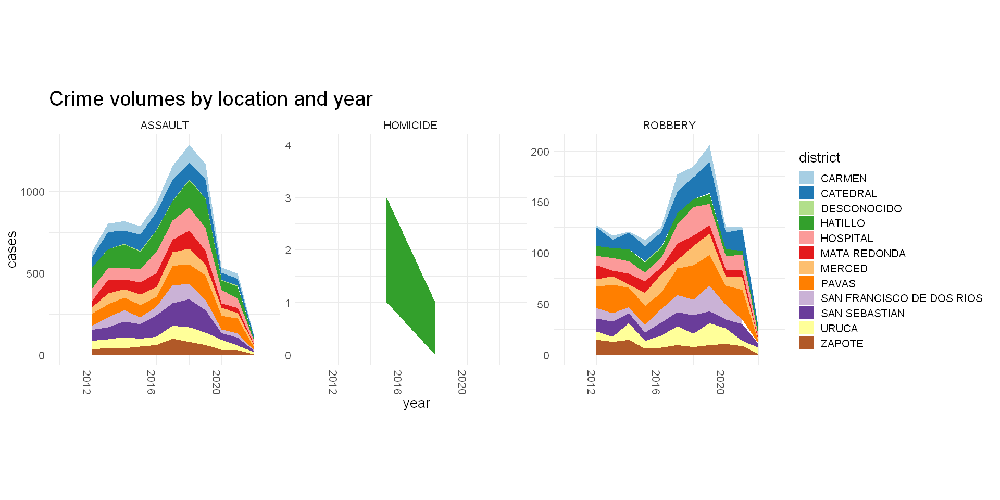

In [2]:
crimes_raw <- read_csv(here::here("data", "costa_rica_crimes_english.csv"), show_col_types = FALSE)

# crime types by location and time - changes over the years and seasonality
# victim types by location

crimes <- crimes_raw |> 
  mutate(Date=lubridate::dmy(Date),
         Time=lubridate::hms(substr(Time, 1, 8))) |>
  janitor::clean_names()

sj_crime_vaw_all <- crimes |> 
  filter(province=="SAN JOSE", 
         canton=="SAN JOSE", 
         crime %in% c("ASSAULT", "HOMICIDE", "ROBBERY", "THEFT") ,
         subtype_crime %in% c("ASSAULT", "COLD WEAPON", "FIREARM","FORCE", "HITTING", "IMMOBILIZATION", 
         "SUFFOCATION/STRANGULATION", "VERBAL INTIMIDATION", "FEMICIDE"),
         gender=="female") |>
   mutate(year=lubridate::year(date))

sj_crime_vaw_all |> 
  filter(year >= 2012) |> 
  count(year, crime, district) |> 
  ggplot (aes (x = as.integer(year), y = n)) + 
      scale_fill_brewer(palette="Paired") +
      geom_area(aes(fill=district)) +
      scale_x_continuous("year", limits=c(2010,2023))+
      facet_wrap (~crime, scales = "free")  +
      theme_minimal() +
      labs (y = "cases", x = "year", title="Crime volumes by location and year") + 
      theme(axis.text.x = element_text(angle = -90),
        aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16))
         

# 2020 - Covid year shows strange behavior which data probably less relevant for "normal" times, we want to analyze in this study.
sj_crime_vaw  <- sj_crime_vaw_all |>
  filter(year >= 2012, year <= 2019) 

To make it clear, we only use years 2012-2019 crime data during the rest of this study.

There is a very spectacular increase in assaults from 2012 until 2019; and the remedy against this type of crime is clearly visible: place people in confinement...
It's hard to draw any conclusion about which district is more dangerous or safer. It would make more sense to add the perspective of the population size or geographical area, as follows.

##### 2.1.1 Crime by population 
We read population and population density data from [INEC](www.inec.cr) public sources, and add these to our crime DB, so we can visualize the level of crime per inhabitant in each of San Jose's districts:

Joining, by = c("year", "canton", "province", "district")
geom_path: Each group consists of only one observation. Do you need to adjust
the group aesthetic?



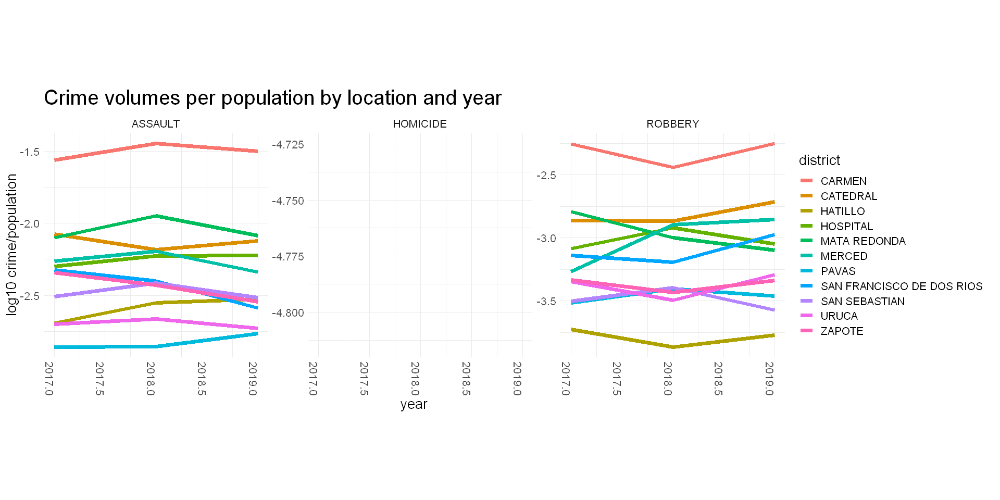

In [3]:
density_20 <- read.csv(here::here('data', 'repoblacionanuario2019-2020-04_converted.csv')) |> select(-Provincia..cantón.y.distrito)
population_20 <- read.csv(here::here('data', 'repoblacionanuario2019-2020-03_converted.csv'))|> select(-Provincia..cantón.y.distrito)
density_17_19 <- read.csv(here::here('data', 'repoblacionanuario2017-2019-21_converted.csv'))|> select(-Provincia..cantón.y.distrito, -X2019)
population_17_19 <- read.csv(here::here('data', 'repoblacionanuario2017-2019-20_converted.csv'))|> select(-Provincia..cantón.y.distrito, -X2019)

density <- density_20 |> 
  full_join(density_17_19, by=c("Provincia", "Canton", "Distrito")) |> 
  mutate(Province=toupper(iconv(Provincia, to='ASCII//TRANSLIT')),
         Canton=toupper(iconv(Canton, to='ASCII//TRANSLIT')),
         District=toupper(iconv(Distrito, to='ASCII//TRANSLIT'))) |> 
  pivot_longer(cols=c('X2017', 'X2018', 'X2019', 'X2020')) |> 
  filter(!is.na(value), value!="-", District !="", Canton !="") |> 
  mutate(value=gsub(" ", "", value)) |> 
  mutate(value=gsub(",", "", value)) |> 
  mutate(year=as.integer(substr(name, 2,5)), density=as.numeric(value)) |> 
  select(-name, -Provincia, -Distrito, -value) |> 
  janitor::clean_names()


population <- population_20 |> 
  full_join(population_17_19, by=c("Provincia", "Canton", "Distrito")) |> 
  mutate(Province=toupper(iconv(Provincia, to='ASCII//TRANSLIT')),
         Canton=toupper(iconv(Canton, to='ASCII//TRANSLIT')),
         District=toupper(iconv(Distrito, to='ASCII//TRANSLIT'))) |> 
  pivot_longer(cols=c('X2017', 'X2018', 'X2019', 'X2020')) |> 
  filter(!is.na(value), value!="-", District !="", Canton !="") |> 
  mutate(value=gsub(" ", "", value)) |> 
  mutate(value=gsub(",", "", value)) |> 
  mutate(year=as.integer(substr(name, 2,5)), population=as.numeric(value)) |> 
  select(-name, -Provincia, -Distrito, -value) |> 
  janitor::clean_names()

sj_crime_vaw_pop <- sj_crime_vaw |> 
  mutate(year=lubridate::year(date)) |> 
  count(year, crime, canton, province, district) |> 
  left_join(population |> 
              filter(canton=="SAN JOSE", province=="SAN JOSE")) |> 
  mutate(crime_pop = n/population) |> 
  filter(!is.na(crime_pop))

sj_crime_vaw_pop |> 
  ggplot (aes (x = as.integer(year), y = log10(crime_pop), color=district)) + 
      scale_fill_brewer(palette="Paired") +
      geom_line(size=2) +
      scale_x_continuous("year", limits=c(2017,2019)) +
      facet_wrap (~crime, scales = "free")  +
      theme_minimal() +
      labs (y = "log10 crime/population", x = "year", title="Crime volumes per population by location and year") + 
      theme(axis.text.x = element_text(angle = -90),
        aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16))


We see Carmen district is by far the most dangerous district of all in terms of crime cases per inhabitant.

Later, in our analysis we will want to compare the geographical and architectural features of San Jose's districts, so we also have to understand how the districts compare to each other in terms of probability of crime. We must not calculate this crime ratio from absolute crime volumes, because higher districts with average crime rate would end up being higher on the list. We want to compare districts by their per-inhabitant crime rate. 

##### The probability of location (Share of crime per inhabitant per location):

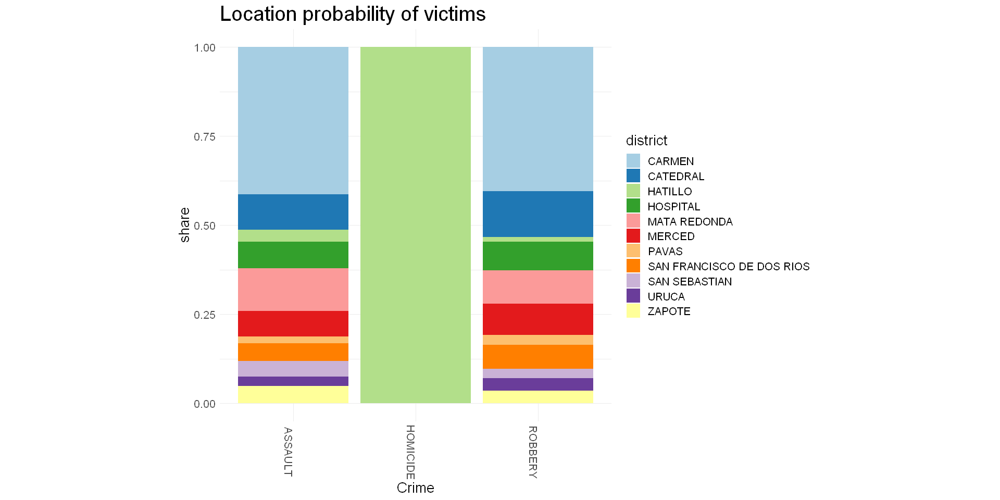

In [4]:
#sj_crime_vaw_pop |> 
#  group_by(year, crime) |> 
#  mutate(tot=sum(crime_pop)) |> 
#  group_by(year, crime, district) |> 
#  summarise(share = crime_pop/tot) |> 
#  ggplot (aes (x = as.integer(year), y = share)) + 
#      scale_fill_brewer(palette="Paired") +
#      geom_area(aes(fill=district)) +
#      facet_wrap (~crime, scales = "free")  +
#      theme_minimal() +
#      labs (y = "number", x = "year", title="Location probability of victims") + 
#      theme(axis.text.x = element_text(angle = -90),
#        aspect.ratio = 1,
#        plot.title=element_text(size=24),
#        text = element_text(size = 16))

sj_crime_vaw_pop |> 
  select(-year) |> 
  group_by(crime) |> 
  mutate(tot=sum(crime_pop)) |> 
  group_by(crime, district) |> 
  summarise(share = sum(crime_pop)/mean(tot), .groups="drop") |> 
  ggplot (aes(fill=district, x=crime, y =share)) + 
      scale_fill_brewer(palette="Paired") +
      geom_bar(position="fill", stat="identity") +
      theme_minimal() +
      theme(axis.text.x = element_text(angle = -90),
        aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16)) +
      labs (y = "share", x = "Crime", title="Location probability of victims") 

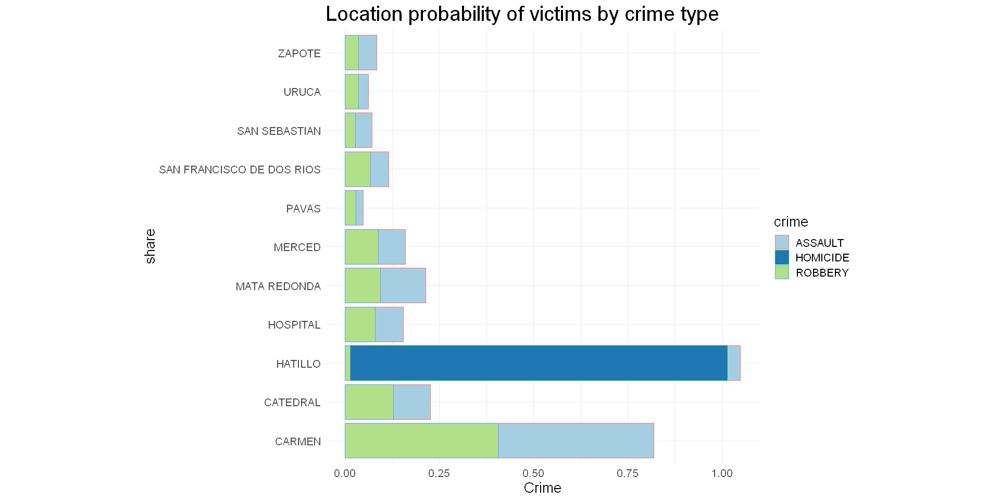

In [5]:
sj_crime_vaw_pop |> 
  select(-year) |> 
  group_by(crime) |> 
  mutate(tot=sum(crime_pop)) |> 
  group_by(crime, district) |> 
  summarise(share = sum(crime_pop)/mean(tot), .groups="drop") |> 
  ggplot (aes(x=share, y =district, color=crime)) + 
      scale_fill_brewer(palette="Paired") +
      geom_col(aes(fill=crime)) +
      theme_minimal() +
      theme(aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16)) +
      labs (y = "share", x = "Crime", title="Location probability of victims by crime type") 

All homicides happen in Hatillo. Carmen leads in assault and robbery; but Mata Redonda and Catedral are also high on the list.

##### Aggregated location probability of crime - our target variable
We remove the crime type from the aggregation, each crime is worth the same (from the point of view of the victim at least).

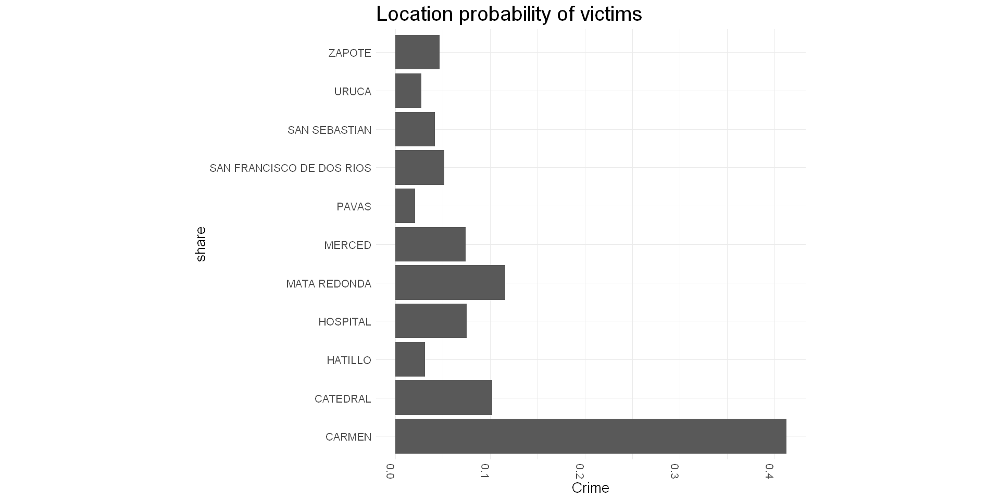

In [6]:
fea_crime_vaw <- 
  sj_crime_vaw_pop |> 
  select(-year) |> 
  mutate(tot=sum(crime_pop)) |> 
  group_by(district) |> 
  summarise(share = sum(crime_pop)/mean(tot), .groups="drop") |> 
  janitor::clean_names()

fea_crime_vaw |> 
  ggplot (aes(x=share, y =district)) + 
      scale_fill_brewer(palette="Paired") +
      geom_col() +
      theme_minimal() +
      theme(axis.text.x = element_text(angle = -90),
        aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16))+
      labs (y = "share", x = "Crime", title="Location probability of victims") 

##### VAW Crime density by population - on map

First loading district map data (conversion is needed due to irregular formatting of arcGIS file)

In [7]:
rex_rings <- 
  rex::rex(
    # start,
    "'rings':",
    capture(name = "geometry", regex(".*")),
    ",'spatialReference':{",
    "'wkid':",
    capture(name = "wkid", numbers),
    except_any_of(numbers),
    "'latestWkid':",
    capture(name = "latest_wkid", numbers)
    # end
  )

# this is the arcGIS re-formatter function:

sf_arcgis_csv <- function(relative_path) {
  
  arcgis <- 
    read_csv(here::here(relative_path), show_col_types = FALSE) |> 
    janitor::clean_names() |> 
    select(-x1) |> 
    # remove blank characters
    mutate(shape = str_remove_all(shape, "[[:space:]]"))
  
  arcgis <- arcgis |>
    # extract geometry parameters from each row
    mutate(data = map(shape, rex::re_matches, rex_rings)) |> 
    unnest(data) |> 
    mutate(across(c(wkid, latest_wkid), as.integer)) |> 
    select(-shape)
  
  arcgis <- arcgis |>
    # head(4) |> 
    # convert ESRI JSON string to WKT: rings -> (multi)polygons  
    mutate(geometry =  str_replace_all(geometry, "\\[", "(" ),
           geometry =  str_replace_all(geometry, "\\]", ")" )) |> 
    mutate(geometry =  str_replace_all(geometry, "(?:,(?=[[:digit:]]+))", " " )) |> 
    mutate(geometry =  str_replace_all(geometry, "\\),\\(", "," )) |> 
    mutate(geometry = paste("MULTIPOLYGON", geometry)) |> 
    # remove empty geometries
    filter(!geometry == "MULTIPOLYGON ()") |> 
    # convert to sf object
    # fixed CSR = 5367 - can be extracted form the latest_wkid column
    sf::st_as_sf(wkt = "geometry", crs = 5367)
  
}

In [8]:

district <- sf_arcgis_csv(here::here("data/arcGIS_zoning_data_san_jose/arcGIS_districts.csv")) |> 
  janitor::clean_names() |> 
  st_transform(crs = 4326) |> 
  st_make_valid() |> 
  mutate(area=st_area(geometry)) |> 
  rename(district=nombre) |> 
  select(-shape_st_area, -shape_st_length) |> 
  mutate(district=toupper(iconv(district, from="UTF-8", to='ASCII//TRANSLIT')))

New names:
* `` -> ...1



In [9]:
map_fea_crime_vaw  <- district |> 
  left_join(fea_crime_vaw) 

pal <- colorNumeric(
  palette = "Reds",
  domain = c(0, max(map_fea_crime_vaw$share))
)

map_fea_crime_vaw |> 
  leaflet() |> 
  addTiles(options = tileOptions(opacity = 1)) |> 
  addPolygons(data=map_fea_crime_vaw, color='grey', opacity = 0.7, weight=1, 
      fillColor=pal(map_fea_crime_vaw$share), fillOpacity=0.7, label=map_fea_crime_vaw$district,
      labelOptions = labelOptions(noHide = TRUE, textsize = "12px", opacity=0.6)) |> 
  addLegend(position = "bottomright", pal=pal, title="Crime density", values=map_fea_crime_vaw$share) |> 
  addTitle("San Jose - District crime density by population", "24px") |>
  saveWidget(here::here("submit", "leaflet_crime_density_pop.html"))




Joining, by = "district"



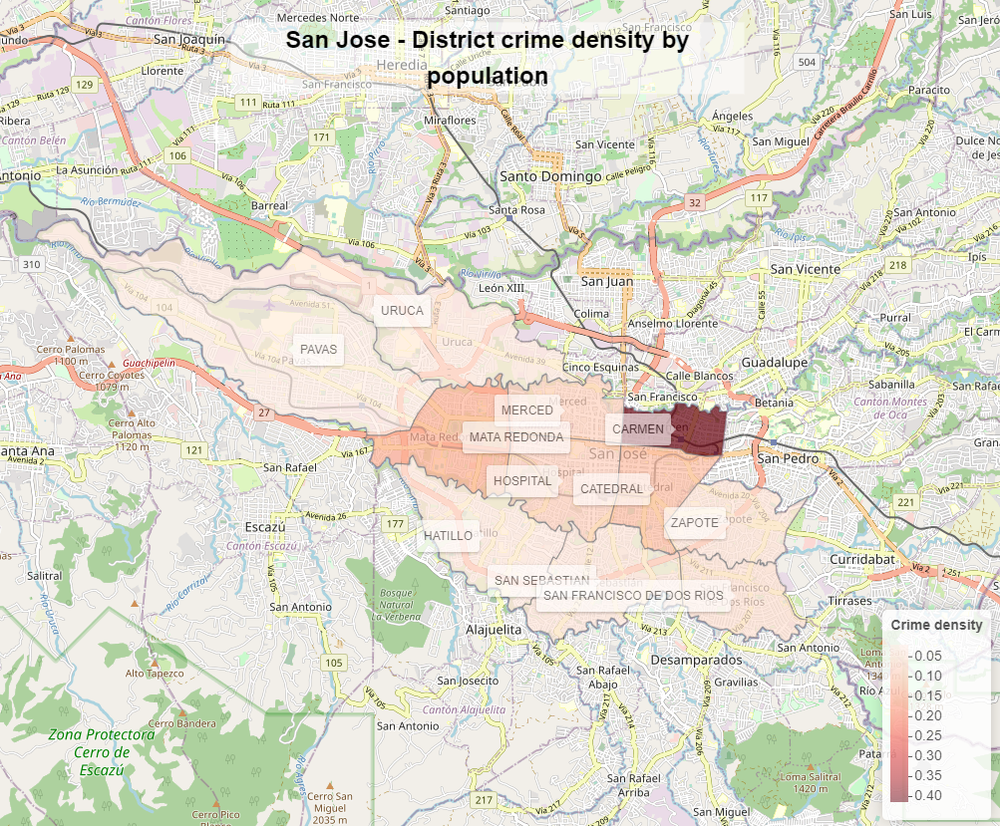


> See interactive map in **Visualizations** section.

Carmen seems very heavily impacted by crime, 40% of crime per inhabintant comes from here. How much is the population here?

In [10]:
population  %>% filter(canton=='SAN JOSE', province=='SAN JOSE', year==2019)  %>% arrange(population)

canton,province,district,year,population
<chr>,<chr>,<chr>,<int>,<dbl>
SAN JOSE,SAN JOSE,CARMEN,2019,3023
SAN JOSE,SAN JOSE,MATA REDONDA,2019,10025
SAN JOSE,SAN JOSE,MERCED,2019,15085
SAN JOSE,SAN JOSE,CATEDRAL,2019,15517
SAN JOSE,SAN JOSE,ZAPOTE,2019,21758
SAN JOSE,SAN JOSE,HOSPITAL,2019,23490
SAN JOSE,SAN JOSE,SAN FRANCISCO DE DOS RIOS,2019,23545
SAN JOSE,SAN JOSE,URUCA,2019,41169
SAN JOSE,SAN JOSE,SAN SEBASTIAN,2019,44877


Carmen is a small district, but its population is 1/3rd of the next smallest population district... This is strange... Our per-inhabitant model may be wrong in the case a district is a typical non-residencial area: few people actually living there, but many going there to work, to have fun or as tourists.

It seems like Carmen district is an outlier from the population perspective, but we should not exclude it from our investigations (not much would remain in scope...).

So let's try the other, probably better approach in this case: crime distribution by district area.


##### 2.1.2 Crime by district area (km^2)

Joining, by = "district"


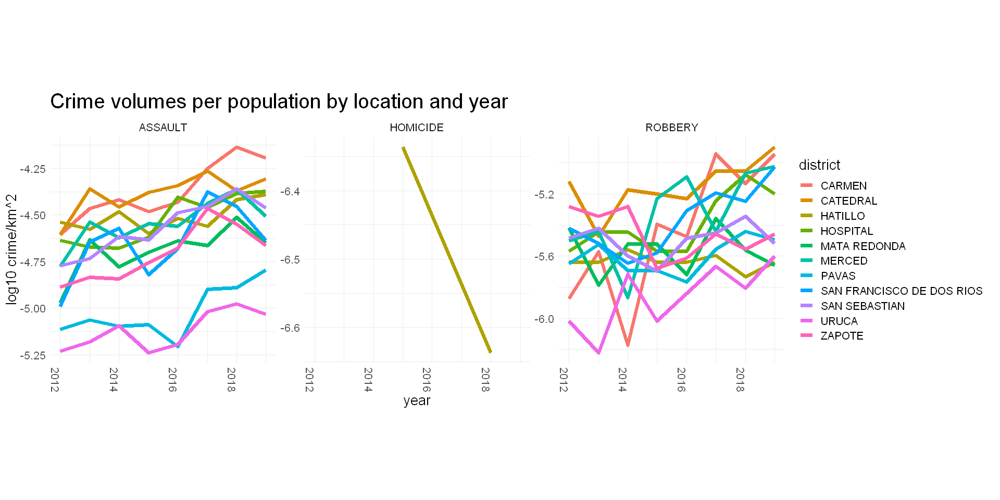

In [11]:
## Adding district size (km^2) to crime data
sj_crime_area <- sj_crime_vaw |> 
  mutate(year=lubridate::year(date)) |> 
  count(year, crime, canton, province, district) |> 
  left_join(district) |> 
  mutate(crime_km2 = n/as.numeric(area)) |> 
  filter(!is.na(crime_km2))

sj_crime_area |> 
  ggplot (aes (x = as.integer(year), y = log10(crime_km2), color=district)) + 
      scale_fill_brewer(palette="Paired") +
      geom_line(size=2) +
      facet_wrap (~crime, scales = "free")  +
      theme_minimal() +
      labs (y = "log10 crime/km^2", x = "year", title="Crime volumes per population by location and year") + 
      scale_x_continuous("year", limits=c(2012,2019)) +
      theme(axis.text.x = element_text(angle = -90),
        aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16))
  

##### The probability of location (Share of crime per district area per location)

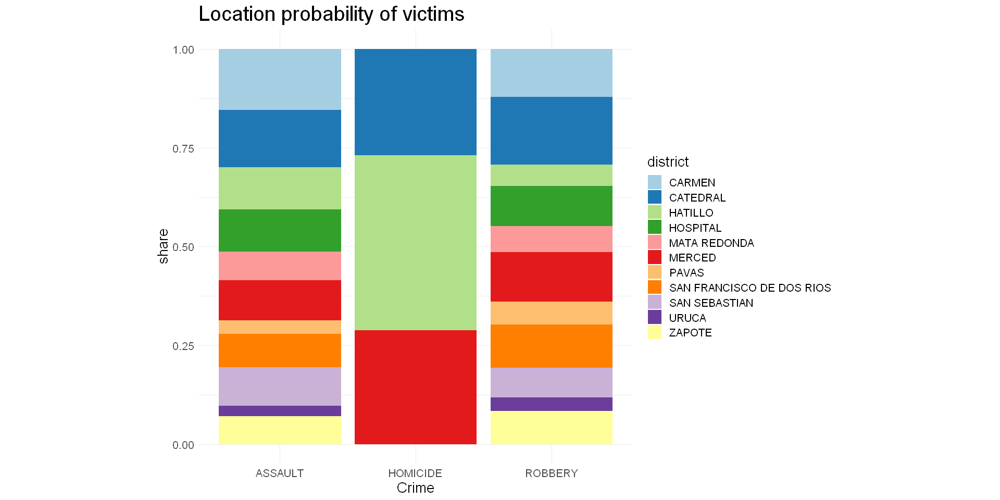

In [12]:
#sj_crime_area |> 
#  group_by(year, crime) |> 
#  mutate(tot=sum(crime_km2)) |> 
#  group_by(year, crime, district) |> 
#  summarise(share = crime_km2/tot) |> 
#  ggplot (aes (x = as.integer(year), y = share)) + 
#  scale_fill_brewer(palette="Paired") +
#  geom_area(aes(fill=district)) +
#  facet_wrap (~crime, scales = "free")  +
#  theme_minimal() +
#  labs (y = "number", x = "year", title="Location probability of victims") + 
#  theme(axis.ticks.x=element_blank())

sj_crime_area |> 
  select(-year) |> 
  group_by(crime) |> 
  mutate(tot=sum(crime_km2)) |> 
  group_by(crime, district) |> 
  summarise(share = sum(crime_km2)/mean(tot), .groups="drop") |> 
  ggplot (aes(fill=district, x=crime, y =share)) + 
      scale_fill_brewer(palette="Paired") +
      geom_bar(position="fill", stat="identity") +
      theme_minimal() +
      theme(aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16)) +
    labs (y = "share", x = "Crime", title="Location probability of victims") 

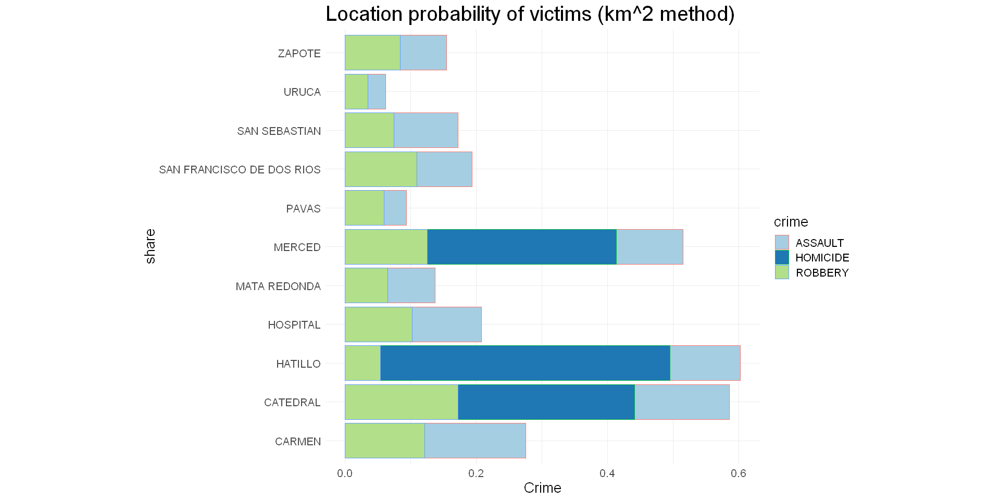

In [13]:
sj_crime_area |> 
  select(-year) |> 
  group_by(crime) |> 
  mutate(tot=sum(crime_km2)) |> 
  group_by(crime, district) |> 
  summarise(share = sum(crime_km2)/mean(tot), .groups="drop") |> 
  ggplot (aes(x=share, y =district, color=crime)) + 
      scale_fill_brewer(palette="Paired") +
      geom_col(aes(fill=crime)) +
      theme_minimal() +
      theme(aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16)) +
  labs (y = "share", x = "Crime", title="Location probability of victims (km^2 method)") 

##### Aggregated location probability of crime for target variable

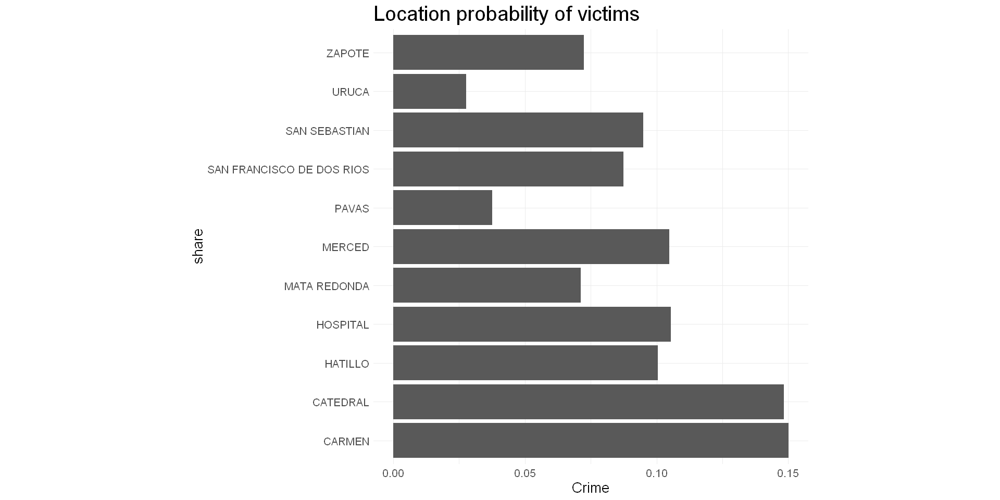

In [14]:
fea_crime_area <- 
  sj_crime_area |> 
  select(-year) |> 
  mutate(tot=sum(crime_km2)) |> 
  group_by(district) |> 
  summarise(share = sum(crime_km2)/mean(tot), .groups="drop") |> 
  janitor::clean_names()

fea_crime_area |> 
  ggplot (aes(x=share, y =district)) + 
      scale_fill_brewer(palette="Paired") +
      geom_col() +
      theme_minimal() +
      theme(aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16)) +      labs (y = "share", x = "Crime", title="Location probability of victims") 

Carmen is still in the lead, but by not as much. It's clear it did not make much sense to use population data due to this being an outlier, in fact.

##### Crime location probability by unit km^2 on map


In [15]:
crime_per_area <- district |> 
  left_join(fea_crime_area)  

pal_crime <- colorNumeric(
  palette = "Reds",
  domain = c(0, max(crime_per_area$share))
)

crime_per_area |> 
    leaflet() |> 
      addTiles(options = tileOptions(opacity = 1)) |> 
      addPolygons(data=map_fea_crime_vaw, color='grey', opacity = 0.7, weight=1, 
          fillColor=pal_crime(crime_per_area$share), fillOpacity=0.7, label=crime_per_area$district,
          labelOptions = labelOptions(opacity=0.6, noHide = TRUE, textsize = "12px")) |> 
      addLegend(position = "bottomright", pal=pal_crime, title="Crime density", values=crime_per_area$share) |> 
      addTitle("San Jose - District crime density by area", "24px")  |>
  saveWidget(here::here("submit", "leaflet_crime_density_area.html"))


Joining, by = "district"


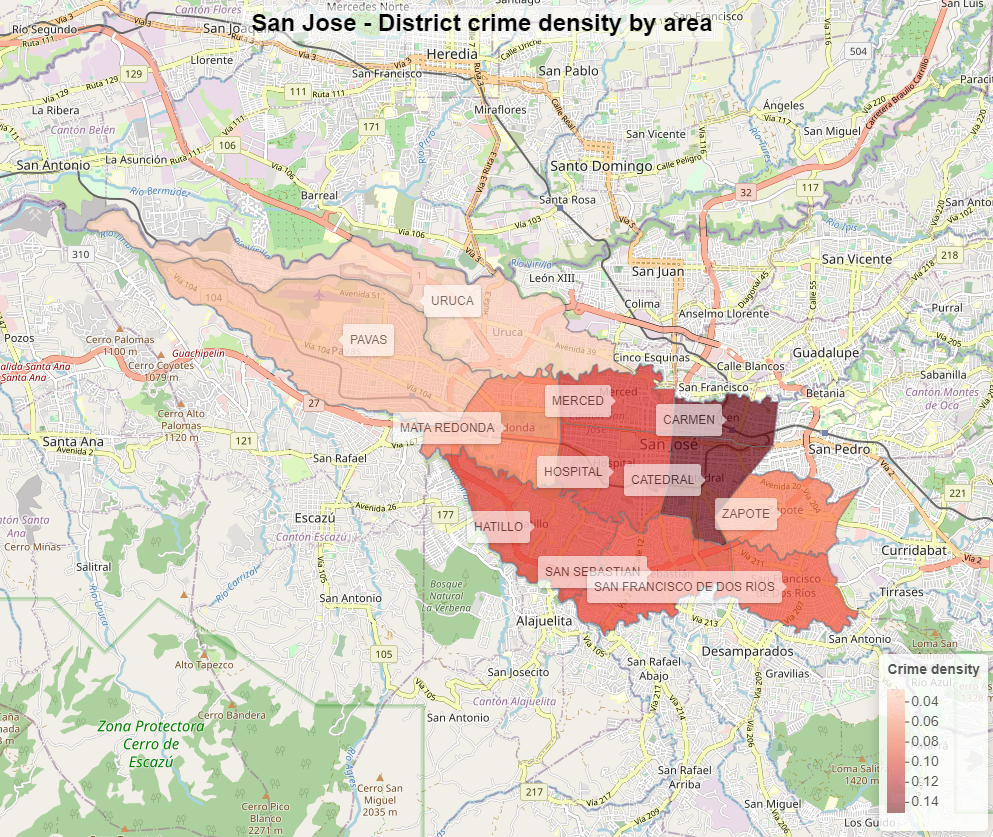

> See interactive map in **Visualizations** section.


#### 2.2 Map layers

In accordance with our methodology, we would like to understand which map features may drive crime, i.e. create hotspots in favour of crime. We expect more cases to happen in districts with more hotspots.
We used articles and common sense to figure out which map layers to investigate, the ones having the highest potential of influencing crime levels.

##### 2.2.1 San Jose building/construction regulation zones
Steps: 
* Reading the arcGIS_zonas.csv from the Challenge dataset
* fixing the format errors as described earlier
* creating a feature set from zonas: we will differentiate the districts from each other based on what portion of their total area is covered by certain zone types (e.g. residencial, commercial, and the subtypes of these)
See [Reglamento de Desarrollo Urbano del Cantón de San José. Disposiciones Generales](http://www.pgrweb.go.cr/scij/Busqueda/Normativa/Normas/nrm_texto_completo.aspx?param1=NRTC&nValor1=1&nValor2=76642&nValor3=95756&strTipM=TC) for all the details.

In [16]:
zonas <- sf_arcgis_csv(here::here("data/arcGIS_zoning_data_san_jose/arcGIS_zonas.csv")) |> 
  janitor::clean_names() |> 
  st_transform(crs = 4326) |> 
  st_make_valid() |> 
  mutate(area = st_area(geometry)) |> 
  select(-shape_st_area)

# Mapping zonas to best matching district
zonas_join <- st_join(
  zonas,
  district,
  largest = TRUE,
  suffix=c("", ".d")
  )

New names:
* `` -> ...1

Warning message:
"One or more parsing issues, see `problems()` for details"
Warning message:
"attribute variables are assumed to be spatially constant throughout all geometries"


##### Zone types
and their distribution within districts by the area they occupy.

In [17]:
# a summary of zone types by the municipality regulations

x <- zonas_join |> st_drop_geometry()
lapply(x[c("categouso", "district")], unique)

### Number and area of Zona categories by district

f_area_zona <- function(var_name, array=zonas_join, id_name="district") {
  array |>
  st_drop_geometry() |> 
  mutate(area = as.numeric(area)) |> 
  group_by_(.dots=list({{id_name}}, {{var_name}})) |> 
  summarise(area=sum(area, na.rm=TRUE), .groups="drop") |>
  group_by_(.dots=list({{id_name}})) |> 
  mutate(area_district = sum(area, na.rm=TRUE)) |> 
  group_by_(.dots=list({{id_name}}, {{var_name}})) |> 
  summarise(area_ratio = area / sum(area_district, na.rm=TRUE), .groups="drop")|> 
  mutate(area_ratio = if_else(is.na(area_ratio), 0, area_ratio)) |> 
  pivot_wider(names_from = var_name, values_from = area_ratio, values_fill = 0) |> 
  janitor::clean_names()
}

feature_zonas <- 
  f_area_zona("categouso") 

$categouso
 [1] "APU"  "ZAVC" "ZR4"  "ZC1"  "ZC2"  "ZC3"  "ZI"   "ZMIC" "ZMRC" "ZR1" 
[11] "ZR2"  "ZR3"  "ZSE" 

$district
 [1] "SAN FRANCISCO DE DOS RIOS" "SAN SEBASTIAN"            
 [3] "HATILLO"                   "ZAPOTE"                   
 [5] "CATEDRAL"                  "HOSPITAL"                 
 [7] NA                          "CARMEN"                   
 [9] "PAVAS"                     "MATA REDONDA"             
[11] "URUCA"                     "MERCED"

Warning message:
"`group_by_()` was deprecated in dplyr 0.7.0.
Please use `group_by()` instead.
See vignette('programming') for more help
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated."
Note: Using an external vector in selections is ambiguous.
i Use `all_of(var_name)` instead of `var_name` to silence this message.
i See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.
This message is displayed once per session.


##### 2.2.2 Public use areas
Same concept as for construction zones.

In [18]:
areas_public <- sf_arcgis_csv(here::here("data/arcGIS_zoning_data_san_jose/arcGIS_areas_public_use.csv")) |> 
  janitor::clean_names() |> 
  st_transform(crs = 4326) |> 
  st_make_valid() |> 
# there are many places without pre-calculated area. We recalculate the area for all.
  mutate(area = st_area(geometry)) |> 
  select(-area_registral)


#Probably interesting categories:
#* Categoria
#* Estado
#* Mantenimiento
#* Uso Actual...

### Number and area of public use categories by district

# calculating ratio of public use area vs. district area for each district

public_area_ratio <- areas_public |>
  st_drop_geometry() |> 
  group_by(id_distrito) |> 
  summarise(area_public = sum(area, na.rm=TRUE)) |> 
  left_join(district |> 
              st_drop_geometry() |> 
              select(district, id_distrito, area)
            , by="id_distrito") |> 
  mutate(public_area_ratio = as.numeric(area_public / area))

f_area_apu <- function(var_name, array=areas_public, id_name="id_distrito") {
  array |>
  st_drop_geometry() |> 
  mutate(area = as.numeric(area)) |> 
  group_by_(.dots=list({{id_name}}, {{var_name}})) |> 
  summarise(area=sum(area, na.rm=TRUE), .groups="drop") |>
  group_by_(.dots=list({{id_name}})) |> 
  mutate(area_district = sum(area, na.rm=TRUE)) |> 
  group_by_(.dots=list({{id_name}}, {{var_name}})) |> 
  summarise(area_ratio = area / sum(area_district, na.rm=TRUE), .groups="drop")|> 
  pivot_wider(names_from = var_name, values_from = area_ratio, values_fill = 0) |> 
  janitor::clean_names()
}

feature_areas_public <- 
  f_area_apu("categoria")|> 
  left_join(f_area_apu("estado"), by="id_distrito") |> 
  left_join(f_area_apu("mantenimiento_parques"), by="id_distrito") |> 
  left_join(f_area_apu("uso_actual"), by="id_distrito") |> 
## adding ratio of public use area within district vs. district area  
  left_join(public_area_ratio |> select(public_area_ratio, id_distrito), by="id_distrito") |> 
  left_join(district |> st_drop_geometry() |> select(district, id_distrito), by="id_distrito") |> 
  select(-id_distrito)


New names:
* `` -> ...1



##### 2.2.4 Bars, pubs, etc.

There are certain type of places (bars, pubs, etc.) that typically attract more people. More people means higher probability of crime as well. We used OpenStreetMap data to locates such places.

Places that are taken into considerations include: bars, biergartens, pubs, brothels, love hotels, night clubs and hostels.
We would like to know where these places are located, and check whether the amount of these kind of places somehow correlate with district crime density.

In [19]:
### Download bars, pubs, bordellos, etc.

JS_ent <- opq (bbox = getbb("Cantón San José cr")) %>%
  add_osm_feature(key = 'amenity', value = c('bar', 'biergarten',
                                             'pub', 'brothel',
                                             'love_hotel',
                                             'night_club')) %>% 
  osmdata_sf() 

JS_hostels <- opq (bbox = getbb("Cantón San José cr")) %>%
  add_osm_feature (key = 'tourism', value = 'hostel') %>%
  osmdata_sf() 

JS_unique<- unique_osmdata (c(JS_ent, JS_hostels))

commonfields <- intersect (names( JS_unique$osm_points ),
                           names( JS_unique$osm_polygons) )

Objects <- rbind (
  st_centroid( JS_unique$osm_polygons) %>% 
    select (commonfields),
  JS_unique$osm_points %>%
    select (commonfields)) 

Warning message in st_centroid.sf(JS_unique$osm_polygons):
"st_centroid assumes attributes are constant over geometries of x"
Note: Using an external vector in selections is ambiguous.
i Use `all_of(commonfields)` instead of `commonfields` to silence this message.
i See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.
This message is displayed once per session.


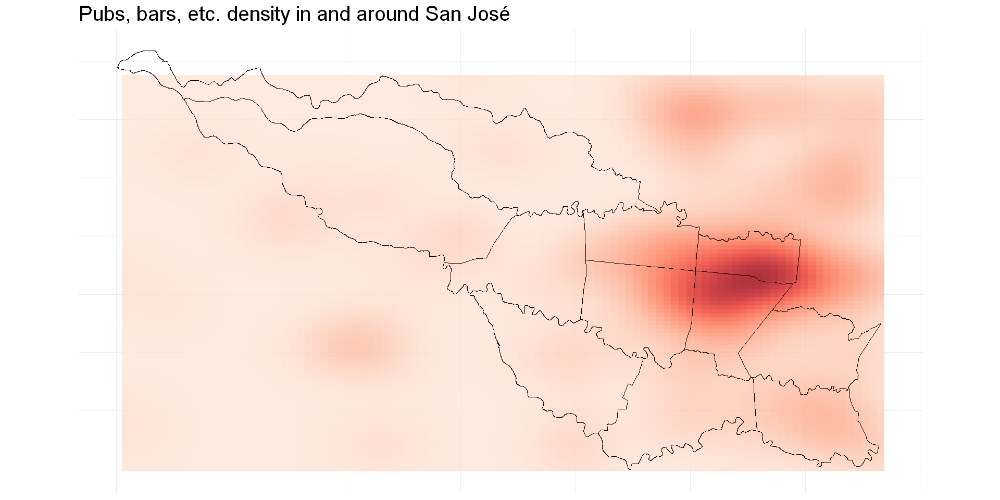

In [20]:
#options(repr.plot.height = 4, repr.plot.width = 4)

pal <- colorNumeric(
  palette = "plasma",
  domain = c(0,2000))
  
ggplot() +
  stat_density_2d(data = Objects, 
                  mapping = aes(x = purrr::map_dbl(geometry, ~.[1]),
                                y = purrr::map_dbl(geometry, ~.[2]),
                                fill = stat(-density)),
                  geom = 'tile',
                  contour = FALSE,
                  alpha = 0.8) +
  scale_fill_distiller(palette = 'Reds') +
  geom_sf (data = district, fill = NA, color = "black") +
  theme_minimal() +
  labs (title = "Pubs, bars, etc. density in and around San José", x="", y = "") +
  theme(axis.title.x=element_blank(),
        axis.text.x=element_blank(),
        axis.ticks.x=element_blank(),
        axis.title.y=element_blank(),
        axis.text.y=element_blank(),
        axis.ticks.y=element_blank(),
        legend.position="none", 
        plot.title=element_text(size=24),
        text = element_text(size = 16)) 
  
#options(repr.plot.height = 7, repr.plot.width = 7)

In [21]:
Pubs_in_Distr <- st_join(Objects, district, join = st_within) %>%
  filter (!is.na(district)) %>%
  st_drop_geometry() %>%
  group_by (district) %>%
  summarise (Pubs = n())


Counting the number of potentially risky entertainment places per district:

In [22]:
Pubs_in_Distr

district,Pubs
<chr>,<int>
CARMEN,43
CATEDRAL,48
HATILLO,6
HOSPITAL,29
MATA REDONDA,3
MERCED,18
PAVAS,7
SAN FRANCISCO DE DOS RIOS,23
SAN SEBASTIAN,11


#### 2.3 Google reviews

Google reviews provide provide an overall public opinion rating about certain map locations, along with descriptions in some cases. We can use these for identifying places where people felt being in danger. 

Two review files have been provided by WDL organizers, one is a transport station review, the other one is a rveiw of public park areas.

First these files are read and converted from JSON to data table format with the "rraplly" package.

The structure of the files is such that some data are related to a certain place (e.g. place name, place geospatial coordinates, overall rating, etc.). Reviews are also given to places (i.e. reviews are related to places in a 1:n place:review relation). There are certain important parameters that are related to reivews (i.e. on step deeper in hierarchy than place), such as the review text itself, the rating of that individual review, date of the review, name of reviewer, etc.

Therefore information is read to two tables, one table cintains the place level data, while the other table contains review level data. There is a link between these tow tables, that is the place ID, which is an 'L2' sequence number assigned by "rrapply".

In [23]:
tr_place_level <- read_json ( here::here("data/reviews/google_reviews_transit.json")) |> 
  rrapply(how = "melt") |> 
  filter(L3 == "result") |> 
  mutate (place_ID = L2) |> 
  filter (L4 %in% c("formatted_address", "rating", "name", "geometry")) |> 
  
  # set NA columns to "" and merge L4 - L7 (and to column names later)
  mutate( across(everything(), ~replace_na(.x, "")) ) |>
  unite ("feature", L4:L7, sep = " " ) |> 
  mutate (feature = str_trim (feature, "right")) |>
  
  # create wide df, move Lx values to columns
  select (feature, place_ID, value, value)|>
  pivot_wider (names_from = feature) |> 
  
  # convert geo and rating variables to numeric
  mutate_at(vars(starts_with("geometry") | starts_with ("rating")), 
            list(as.numeric)) |> 
  data.frame()


### read review and related data
tr_reviews <- 
  read_json ( here::here("data/reviews/google_reviews_transit.json")) |> 
  rrapply(how = "melt") |> 
  filter(L3 == "result") |> 
  mutate (place_ID = L2) |> 
  filter (L4 == "reviews") |> 
  filter (L6 %in% c("author_name", "rating", "text", "time", "language")) |>
  select (place_ID, review_ID = L5, feature = L6, value) |>
  pivot_wider (names_from = feature) |> 
  mutate (time = as.POSIXct(as.numeric(time), origin="1970-01-01", tz = "America/Chicago")) |>
  data.frame() 

### Reading the public park review file

# Reading place level information
### read Place level (L4) data
pr_place_level <- read_json ( here::here("data/reviews/google_reviews_parks.json")) |> 
  rrapply(how = "melt") |> 
  filter(L3 == "result") |> 
  mutate (place_ID = L2) |> 
  filter (L4 %in% c("formatted_address", "rating", "name", "geometry")) |> 
  
  # set NA columns to "" and merge L4 - L7 (and to column names later)
  mutate( across(everything(), ~replace_na(.x, "")) ) |>
  unite ("feature", L4:L7, sep = " " ) |> 
  mutate (feature = str_trim (feature, "right")) |>
  
  # create wide df, move Lx values to columns
  select (feature, place_ID, value, value)|>
  pivot_wider (names_from = feature) |> 
  
  # convert geo and rating variables to numeric
  mutate_at(vars(starts_with("geometry") | starts_with ("rating")), 
            list(as.numeric)) |> 
  data.frame()

### read review and related data
pr_reviews <- 
  read_json ( here::here("data/reviews/google_reviews_parks.json")) |> 
  rrapply(how = "melt") |> 
  filter(L3 == "result") |> 
  mutate (place_ID = L2) |> 
  filter (L4 == "reviews") |> 
  filter (L6 %in% c("author_name", "rating", "text", "time", "language")) |>
  select (place_ID, review_ID = L5, feature = L6, value) |>
  pivot_wider (names_from = feature) |> 
  mutate (time = as.POSIXct(as.numeric(time), origin="1970-01-01", tz = "America/Chicago")) |>
  data.frame() 

##### A bit of EDA of parks and transport reviews

##### Showing data in map

##### Read San Jose district data 

The purpose of this step is just to see how reviews geographically spread across districts.

In [24]:
### read San Jose districts from relevant arcGIS file

sj_districts <- 
  sf_arcgis_csv("data/arcGIS_zoning_data_san_jose/arcGIS_districts.csv") |> 
  janitor::clean_names() |> 
  st_transform(crs = 4326) |> 
  st_make_valid()

##### Showing Transport review places on map

# Transform transport place level data to sf.

projcrs <- "+proj=longlat +datum=WGS84 "

df_t <- 
  tr_place_level |> 
  sf::st_as_sf(                    
               coords = c("geometry.location.lng",
                          "geometry.location.lat"),
               crs = projcrs)

#Show transport stations on map

df_t |> leaflet::leaflet() |> leaflet::addTiles () |> 
  leaflet::addCircles (
                       label =  ~name, weight = 1) |>
  leaflet::addRectangles(lng1 = ~geometry.viewport.northeast.lng,
                         lat1 = ~geometry.viewport.northeast.lat,
                         lng2 = ~geometry.viewport.southwest.lng,
                         lat2 = ~geometry.viewport.southwest.lat,
                         fillColor = "transparent") |>
  leaflet::addPolygons (data = sj_districts, opacity = 0.5, weight=1, color = "grey", fillOpacity=0.3) |> 
  addTitle("Location of reviewed items in transport category", "24px") |>
  saveWidget(here::here("submit", "leaflet_transport.html"))

New names:
* `` -> ...1



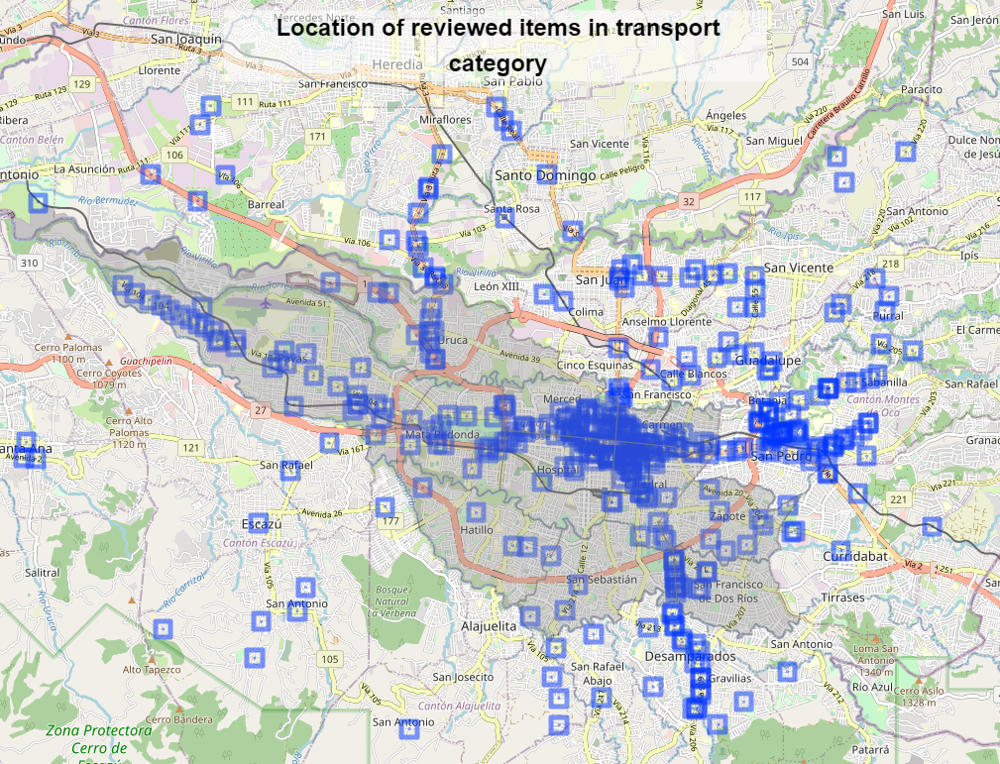

> See interactive map in **Visualizations** section.

In [25]:
##### Showing Park review places on map

#Transform park place level data to sf.
projcrs <- "+proj=longlat +datum=WGS84 "

df_p <- 
  pr_place_level |> 
  sf::st_as_sf(                    
               coords = c("geometry.location.lng",
                          "geometry.location.lat"),
               crs = projcrs)
#Show parks on map

df_p |> leaflet::leaflet() |> leaflet::addTiles () |> 
  leaflet::addCircles (
                       label =  ~tr_place_level$name, weight = 1) |>
  leaflet::addRectangles(lng1 = ~geometry.viewport.northeast.lng,
                         lat1 = ~geometry.viewport.northeast.lat,
                         lng2 = ~geometry.viewport.southwest.lng,
                         lat2 = ~geometry.viewport.southwest.lat,
                         fillColor = "transparent") |>
  leaflet::addPolygons(data = sj_districts, opacity = 0.5, color = "red") |> 
addTitle("Location of reviewed items in park category", "24px")  |>
  saveWidget(here::here("submit", "leaflet_park.html"))

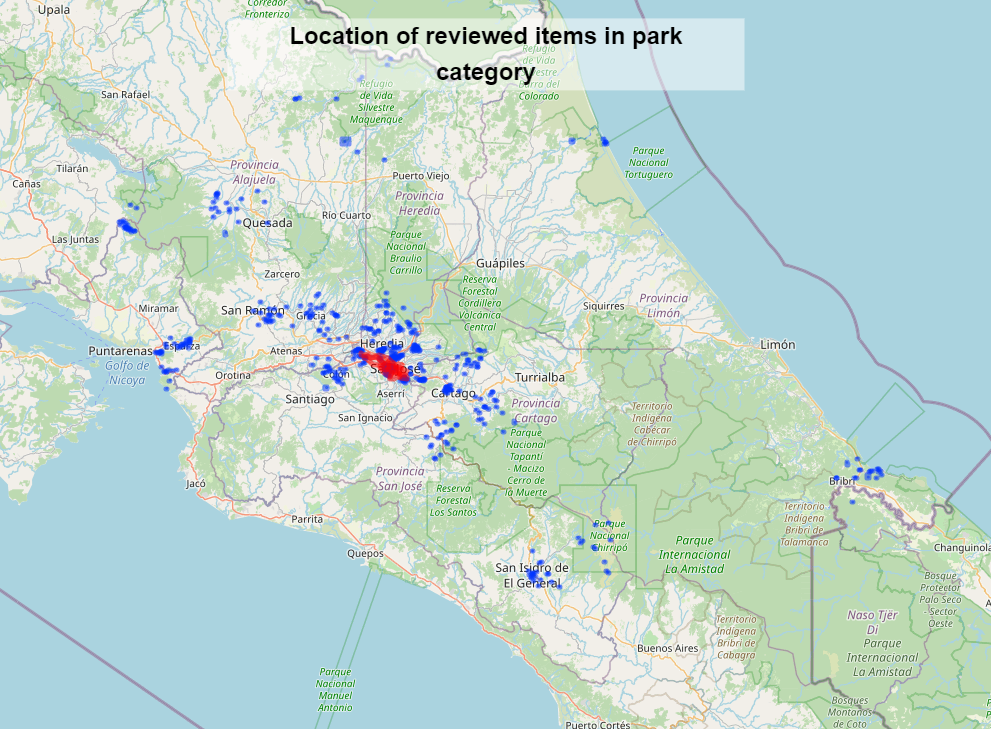
> See interactive map in **Visualizations** section.

Conclusion: most transport reviews are in San Jose and some other cities, parks are from all over.

##### Review times

First and last reviews:

In [26]:
tr_reviews |>
  summarise (min = min (time), max = max(time))

pr_reviews |>
  summarise (min = min (time), max = max(time))

#Number of reviews per years

tr_reviews |>
  mutate (year = format(time, "%Y")) |>
  group_by (year) |>
  summarise (n())

pr_reviews |>
  mutate (year = format(time, "%Y")) |>
  group_by (year) |>
  summarise (n())

min,max
<dttm>,<dttm>
2012-02-20 08:08:34,2022-05-02 15:00:11


min,max
<dttm>,<dttm>
2013-07-25 01:03:56,2022-05-02 17:16:13


year,n()
<chr>,<int>
2012,9
2013,17
2014,9
2015,63
2016,209
2017,237
2018,161
2019,137
2020,97


year,n()
<chr>,<int>
2013,1
2014,4
2015,2
2016,12
2017,52
2018,123
2019,220
2020,160
2021,573


Conclusion: transport reviews form 2012, park reviews from 2013, but in reality these are really only last year reviews.

##### Languages

In [27]:
tr_reviews |>
  filter (!toupper(language) %in% c("EN", "", " ")) |>
  filter (substr(toupper(language),1,2) != "EN") |>
  group_by (language) |> 
  summarise (n())

pr_reviews |>
  filter (!toupper(language) %in% c("EN", "", " ")) |>
  filter (substr(toupper(language),1,2) != "EN") |>
  group_by (language) |> 
  summarise (n())

language,n()
<chr>,<int>
es,5
pt,2


language,n()
<chr>,<int>
es,15
pt,2


Conclusion: dominantly English.


#### Risk finding in reviews

Collecting risk words

In [28]:

risk_words <- "unsafe|not safe|un-safe|dangerous|assault|rape|attack|strangulate| choke| kill| murder| gun|weapon|pistol|knife|threat|insult|harras"

unsafe_finder <- function (texts)
{
  risk_words <- "unsafe|not safe|un-safe|dangerous|assault|rape|attack|strangulate| choke| kill| murder| gun|weapon|pistol|knife|threat|insult|harras|careful|scammer|indigente|chusma|ugly|drug|homeless|robbed|thiev|poor lighting"

  
  grepl (risk_words, texts) |
    
  # "not very safe", "don't feel dafe",...
  grepl ("(not|don't|doesn't) [A-Za-z]+ (safe|secure)", texts) |
  
  # "not safe"
  grepl ("(not|don't|doesn't) (safe|secure)", texts)
}

#filter places with unsafe review
unsafe_tr <- 
  tr_reviews |> 
  filter (unsafe_finder (text)) |>
  left_join (tr_place_level, by = "place_ID") 

unsafe_pr <- 
  pr_reviews |> 
  filter (unsafe_finder (text)) |>
  left_join (pr_place_level, by = "place_ID") 

#show on map

unsafe_tr |> 
  leaflet::leaflet() |> 
  leaflet::addTiles () |>
  leaflet::addCircles( lat = ~geometry.location.lat,
                             lng = ~geometry.location.lng,
                             radius = 2, opacity = 0.5, color = "red")|>
  leaflet::addCircleMarkers( lat = ~geometry.location.lat,
                             lng = ~geometry.location.lng,
                             radius = 2, opacity = 0.8, color = "black", data = unsafe_pr) |>
  leaflet::addPolygons(data = sj_districts, opacity = 0.3, color = "gray")  |> 
    addTitle("Location of unsafe items in park category", "24px") |>
  saveWidget(here::here("submit", "leaflet_unsafe_park.html"))

  

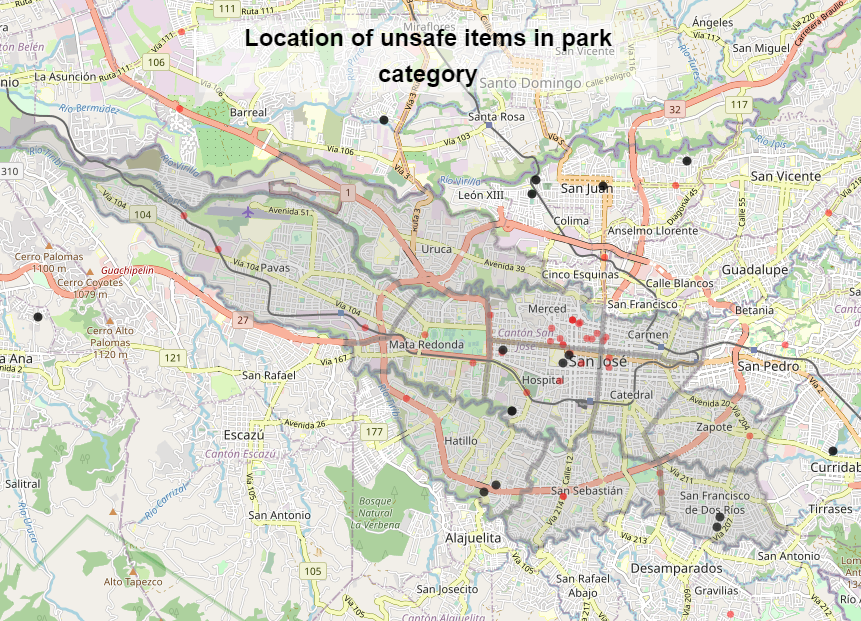
> See interactive map in **Visualizations** section.

#### 2.4 Space syntax analysis / Centrality analysis

The article [Configuration of the street network](https://link.springer.com/article/10.1007/s10940-016-9306-9) asks the question: "Does the Configuration of the Street Network Influence Where Outdoor Serious Violence Takes Place? 

And the answer is: "Regression analyses showed higher levels of integration (a measure of to-movement potential) and choice (through-movement potential) were associated with greater odds of a street segment containing at least one crime. Risk was also higher for segments located near to segments with the highest global choice values. In contrast, connectivity (the number of other segments a street segment is adjacent to) was negatively associated with crime occurrence."

Therefore, now we will carry out the centrality analysis with focus on integration (which locations are in average close to all other locations - i.e. central) and betweenness (which locations people traverse when moving from any point to any other point on the shortest path); and we will select the highest global values, as a good indicator of potential crime hotspots. (Space Syntax analysis)

To start with, we need the Axial map of San Jose: we use the ArcGIS Centro Vías map layer.

Centro vías file contains the route network in form of ¨paths¨, i.e. graph edges. Instead of the usual closed polygon format, used everywhere else on maps, here we have lines only. These will be the edges of the route network graph.

In [29]:
# * `data/arcGIS_zoning_data_san_jose/arcGIS_centro_vias.csv`
cv <- read_csv(here::here("data/arcGIS_zoning_data_san_jose/arcGIS_centro_vias.csv")) |> 
  janitor::clean_names() 

# we need LINESTRING!
edges_int <- cv |> 
  mutate(shape=gsub("'", '"', shape)) |> 
  rowwise() |> 
  mutate(js=list(fromJSON(shape))) |>
  ungroup() |> 
  slice(-c(1143, 1244, 1343, 1344, 2094, 2166, 2610, 2747, 2789, 2792,
           3169, 3330, 3383, 3384, 3385, 3419, 3594, 3595, 4964, 4965,
           6161, 6633, 7000, 8491, 8592, 8944, 9924)) |> 
  rowwise() |> 
  mutate(st_mps = sfc_linestring(matrix(js$paths, ncol=2L))) 

edges <- edges_int |> 
  select(-js) |> 
  st_as_sf(crs=5367) |> 
  st_transform(crs=4326)

## Sfnetwork
net <- as_sfnetwork(edges, directed=FALSE)

### axial map - leaflet
pal <- colorFactor(
  palette = "plasma",
  domain = NULL)

nodes <- st_as_sf(net, "nodes")


New names:
* `` -> ...1

Rows: 10056 Columns: 13
-- Column specification --------------------------------------------------------------------------------
Delimiter: ","
chr (9): Administracion, Cod_Segmento, Jerarquia, Nombre, Nomenclatura, Nume...
dbl (4): ...1, Id_Distrito, OBJECTID, Shape.STLength()

i Use `spec()` to retrieve the full column specification for this data.
i Specify the column types or set `show_col_types = FALSE` to quiet this message.


Unfortunately, after trying the integration centrality calculation, it turned out that our axial map map consists of several disjoint graphs:

In [30]:
with_graph(net, graph_is_connected())
# returns False -> we have disjoint graphs.

[1] FALSE

The centrality integration algorithm fails running on this kind of data. (The disjoint graphs could be the result of an error during data export from arcGIS.)
Solution: we eliminate the minor disjoint graphs. This is not a problem because we still keep 95%+ of the street network data.
You can see here which parts of the data we keep (blue) and what we drop.

In [31]:
net_comps <- net |> 
  activate(nodes) |> 
  mutate(group = group_components()) |>
  mutate(keep = (group==1))

nodes_comps <- st_as_sf(net_comps, "nodes")

pal <- colorFactor(
  palette = "Set1",
  domain = c(TRUE, FALSE)
)

net_comps |> 
  leaflet() |> 
  addTiles(options = tileOptions(opacity = 0.5)) |> 
  addPolygons(data=st_as_sf(net_comps, "edges"), color='grey', opacity = 0.8, weight=1) |> 
  addCircles(data=nodes_comps, color=pal(nodes_comps$keep), radius=5, opacity=1, weight = 2, label = nodes_comps$keep) |> 
  addTitle("San Jose axial street network", "18px") |>
  saveWidget(here::here("submit", "leaflet_disjoint.html"))


# Let's choose group 1 only

net_one <- net_comps |> 
  filter(group == 1)

net_integration <- net_one %>%
  activate("nodes") %>%
  mutate(integr = centrality_integration())

nodes_integration <- st_as_sf(net_integration, "nodes")

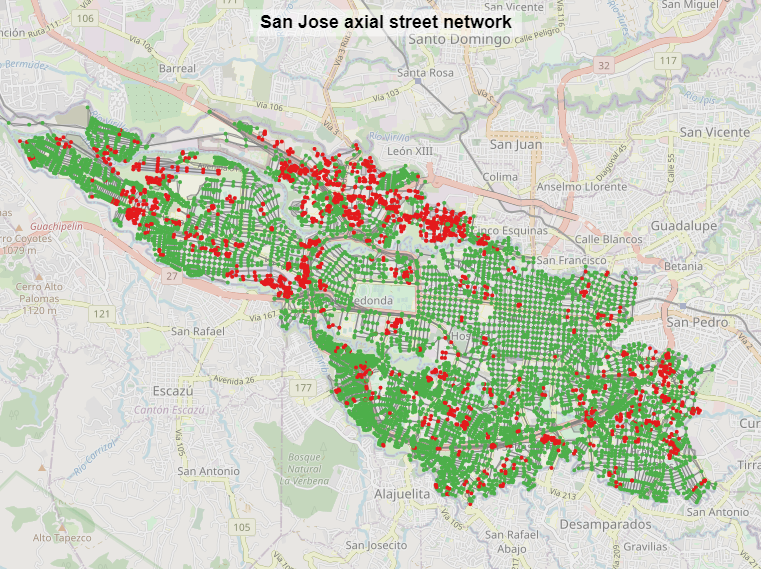
> See interactive map in **Visualizations** section.

##### Centrality analysis: Choice or Betweenness

Warning message in betweenness(graph = graph, v = V(graph), directed = directed, :
"'nobigint' is deprecated since igraph 1.3 and will be removed in igraph 1.4"


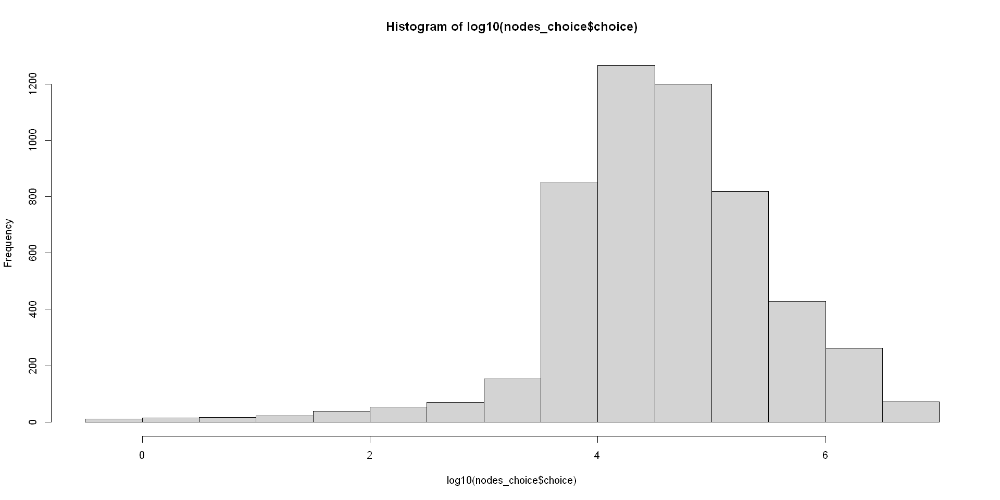

In [32]:
net_choice <- net_one %>%
  activate("nodes") %>%
  mutate(choice = centrality_betweenness())

nodes_choice <- st_as_sf(net_choice, "nodes")
edges_choice <- st_as_sf(net_choice, "edges")
breaks_choice <- hist(nodes_choice$choice, plot=FALSE)$breaks


pal <- colorNumeric(
  palette = "plasma",
  domain = c(0, max(nodes_choice$choice))
)

#edges |> 
#  leaflet() |> 
#  addTiles(options = tileOptions(opacity = 0.5)) |> 
#  addPolygons(data=edges_choice, color='grey', opacity = 0.6, weight=0.5) |> 
#  addCircles(data=nodes_choice, color=pal((nodes_choice$choice)), radius=log10(nodes_choice$choice)*2, weight=0.5, opacity=0.6, fillOpacity=0.4, fillColor=pal((nodes_choice$choice))) |> 
#  addLegend(position = "bottomright", pal=pal, title="Betweenness / Choice", values=breaks_choice) |> 
#  addTitle("San Jose - Choice / Betweenness map", "18px")


hist(log10(nodes_choice$choice)) 

Out of all these points, we need the areas with highest betweenness.

##### Selecting the highest values of Choice / Betweenness

In [33]:
nodes_BW_high <- nodes_choice |> 
  filter(choice > 1e+06)

edges |> 
  leaflet() |> 
  addTiles(options = tileOptions(opacity = 0.5)) |> 
  addPolygons(data=edges_choice, color='grey', opacity = 0.6, weight=0.5) |> 
  addCircles(data=nodes_BW_high, color=pal(nodes_BW_high$choice), radius=log10(nodes_BW_high$choice)*5, weight=2, opacity=0.7, fillOpacity=0.6, fillColor=pal(nodes_BW_high$choice)) |> 
  addLegend(position = "bottomright", pal=pal, title="Betweenness / Choice", values=breaks_choice) |> 
  addTitle("San Jose - Highest Choice / Betweenness points", "18px")  |>
  saveWidget(here::here("submit", "leaflet_choice.html"))



Warning message in pal(c(r[1], cuts, r[2])):
"Some values were outside the color scale and will be treated as NA"


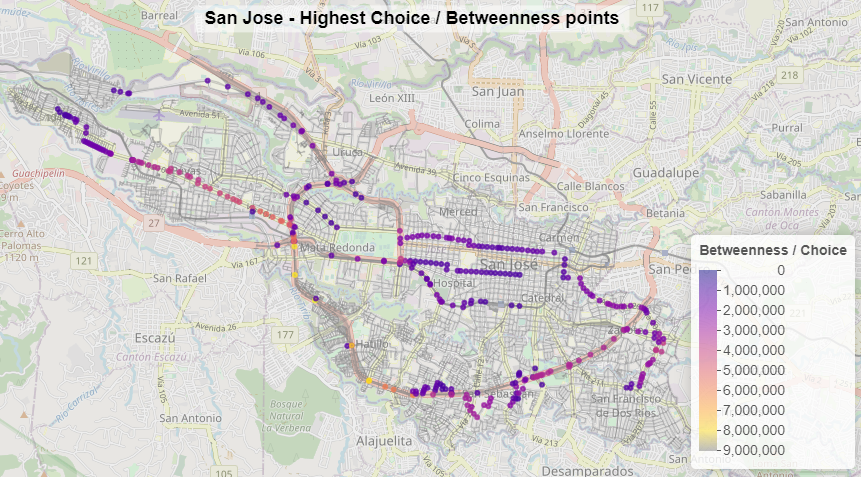

> See interactive map in **Visualizations** section.

##### Centrality analysis: Integration

In [34]:
net_integr <- net_one %>%
  activate("nodes") %>%
  mutate(choice = centrality_integration())


nodes_integr <- st_as_sf(net_integr, "nodes")
edges_integr <- st_as_sf(net_integr, "edges")
breaks_choice <- hist(nodes_integr$choice, plot=FALSE)$breaks

pal <- colorNumeric(
  palette = "plasma",
  domain = c(min(nodes_integr$choice), max(nodes_integr$choice))
)

nodes_integr |> 
  leaflet() |> 
  addTiles(options = tileOptions(opacity = 0.5)) |> 
  addCircles(data=nodes_integr, color=pal(nodes_integr$choice), opacity = 1, radius=10) |> 
  addPolygons(data=edges_integr, color='grey', opacity = 0.6, weight=0.5) |> 
  addLegend(position = "bottomright", pal=pal, title="Integration", values=breaks_choice) |> 
  addTitle("San Jose - Integration map", "18px")  |>
  saveWidget(here::here("submit", "leaflet_integration.html"))

Warning message in pal(c(r[1], cuts, r[2])):
"Some values were outside the color scale and will be treated as NA"


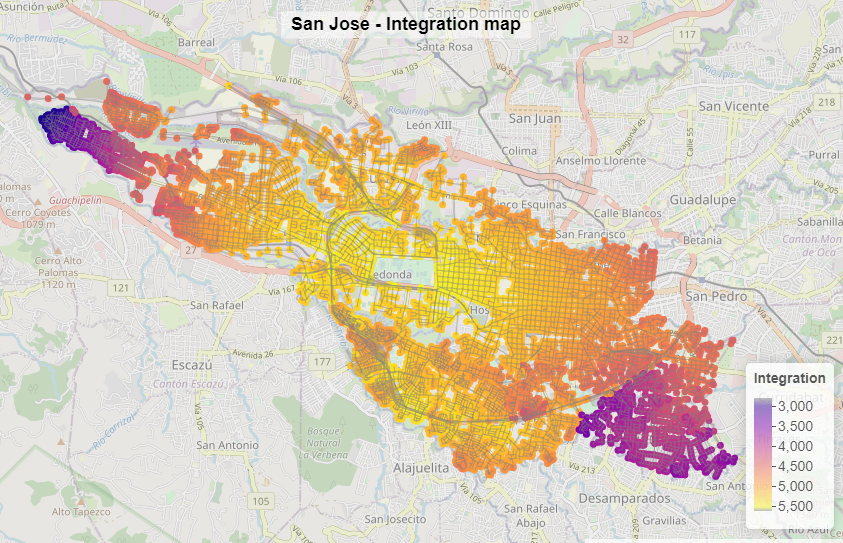
> See interactive map in **Visualizations** section.

The distribution of integration score is displayed on the following histogram. The highest values correspond to the busiest areas of the city; the areas that are the most important from the point of view of finding potential micro-hotspots of crime.

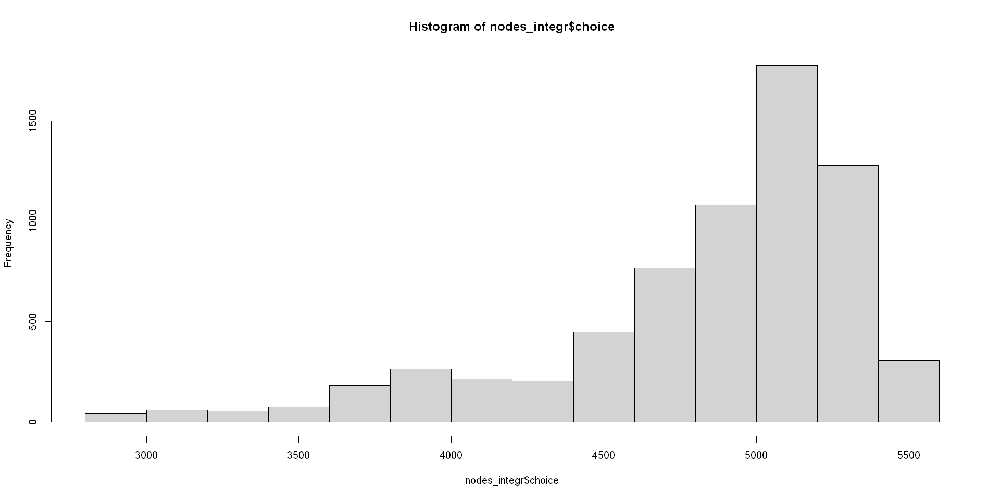

In [35]:
hist(nodes_integr$choice)

##### Selecting the highest integration areas
The very yellow part of the above map comes from the areas above ~5200 integration score. (This value can be tuned... the point here is to take value high enough, no to cover all areas of the city; otherwise it would not be able to highlight hotspots.)

In [36]:
nodes_integr_high <- nodes_integr |> 
  filter(choice > 5200)

### 3. Safety index / crime hotspot model

#### 3.1 Crime data and map layer correlation

Map layers are analyzed for correlation with VAW crime data. This is _not_ a causality analysis, we just observe apparent space-wise correlation between crime density and certain features on the map, in order to identify crime micro-hotspots.

Let's go through the map layers, and see which geographical areas correlate with crime density per district. Here we can simply use Pearson correlation.

##### 3.1.1 Zones
Correlation between distribution of zone types vs. crime density, where correlation is higher than 0.5:

In [37]:
mod <- fea_crime_area |> 
  left_join(feature_zonas)
corr <- cor(mod$share, mod[-1])
df_cor <- data.frame(t(corr))
colnames(df_cor)[1] <- "correlation"
df_cor |> 
  filter(row.names(df_cor)!="share", correlation > 0.5) 

Joining, by = "district"


,correlation
,<dbl>
zc2,0.6211379
zmrc,0.7792277


Zona Commercial 2 and Zone Mixed Residencial Commercial correlate the most with crime data (i.e. districts with higher levels of these types of areas tend to have higher crime level.)

2 pictures of ZC2 showing areas where people typically go for shopping or doing business - most likely a typical downtown area. Pavement seems narrow with trees as obstacles of visibility. (But, as mentioned in our Summary, we don't exactly know when the street violence cases happen in San Jose, we can just assume it, based on literature or common sense.)

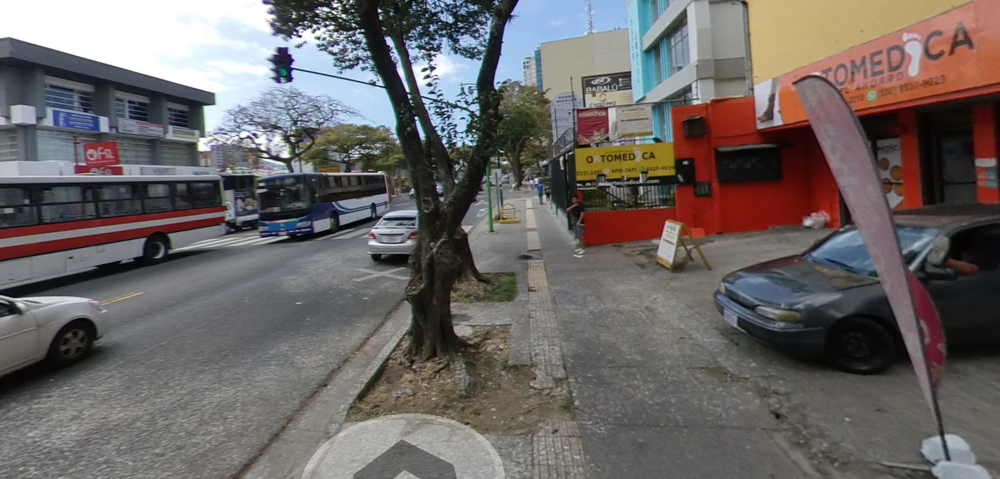

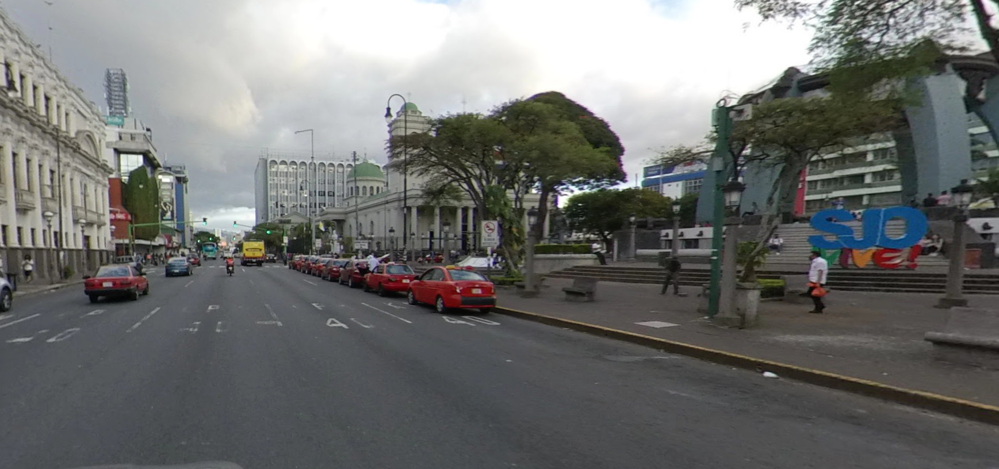

In [38]:
hotspot_type <- toupper(rownames(df_cor |> 
  filter(row.names(df_cor)!="share", correlation > 0.5) 
))

hotspot_zonas <- zonas |> 
                   mutate(label = categouso) |> 
                   select(label) |> 
                   filter(label %in% hotspot_type)

##### 3.1.2 Public use areas
Correlation between Public Use Area types and crime location share

In [39]:
mod <- fea_crime_area |> 
  left_join(feature_areas_public)

corr <- cor(mod$share, mod[-1])
df_cor <- data.frame(t(corr))
colnames(df_cor)[1] <- "correlation"
df_cor |> 
  filter(row.names(df_cor)!="share", correlation > 0.7) 

hotspot_type <- toupper(rownames(df_cor |> 
  filter(row.names(df_cor)!="share", correlation > 0.5) 
))

clean_label <- function(input) {
  gsub(" ", "_", toupper(iconv(input, from="UTF-8", to='ASCII//TRANSLIT')))
}

hotspot_public_use_area <- areas_public |> 
      mutate(categoria = clean_label(categoria),
             estado = clean_label(estado),
             uso_actual = clean_label(uso_actual),
             mantenimiento_parques = clean_label(mantenimiento_parques)) |> 
      filter(categoria %in% hotspot_type | 
               estado %in% hotspot_type |
               uso_actual %in% hotspot_type |
               mantenimiento_parques %in% hotspot_type)

Joining, by = "district"


,correlation
,<dbl>
plazoleta,0.7546649


It seems like the only good correlation here comes from "Plazotela" category; "small square".

##### 3.1.3 Unsafe parks, Unsafe transportation, Bars, etc., results of space syntax centrality analysis (High integration, High betweenness)

These points were designed from the beginning as indicators of higher potential crime levels, therefore we can use these as raw hotspot indicators.

In [40]:
sf_unsafe_tr  <- unsafe_tr |> 
  st_as_sf(coords = c("geometry.location.lng", "geometry.location.lat"),crs =4326)|> 
  st_filter(district)

sf_unsafe_pr  <- unsafe_pr |> 
  st_as_sf(coords = c("geometry.location.lng", "geometry.location.lat"),crs =4326) |> 
  st_filter(district)

hotspot_points <- rbind(
  sf_unsafe_pr |> select(name, geometry) |> mutate(type="unsafe_park"),
  sf_unsafe_tr |> select(name, geometry) |> mutate(type="unsafe_transit"),
  Objects |> select(name, geometry) |> mutate(type="bars"),
  nodes_integr_high |> select(name=choice, geometry=st_mps) |> mutate(type="high_integration"),
  nodes_BW_high |> select(name=choice, geometry=st_mps) |> mutate(type="high_betweenness")
)

In [41]:
hotspot_points |> distinct(type)

,type
,<chr>
1,unsafe_park
10,unsafe_transit
68312440,bars
1586,high_integration
1588,high_betweenness


 #### 3.2 The crime model: Hotspot map

Our method consists of placing all known hotspot indicators on the map of San José. Then we calculate for small geographical areas the number of hotspot category indications. E.g. if we looked at a street corner which is located in a ZC2 zone, next to a Plazotela, from where a negative (unsafe) google review was given: we rate this location with a risk level of 3 because of the 3 hotspot indicators. 
We altogether have 7 indicator types in this current model, therefore our "safety" or "hotspot" scale goes from 0 to 7, where 7 is the highest possible hotspot indication. Zero means no risk.

* The methodology is quite generic, it could be applied to any city without much changes.
* We don't say this is the final and best model; we are quite sure more map layers could be added to this model, in order to take into account more geographical features that can influence (create) crime micro-hotspots, such as areas with insufficient street lights during the night, blocked visibility roads, etc. (after understanding their correlation with crime statistics, as we did it in our analysis too.)

All in all, this is a proposal for a methodology of how to build hotspot maps.

The above mentioned small geographical areas must be some kind of a grid; For convenience, we picked Uber's H3 grid, which splits the globe to hexagons of equal areas; the size of which can be pre-set by a resolution factor.
The current resolution lays the hex grid with 66m edge lengths.

First we convert district data to H3 hex format.
Then all our hotspot layers are also converted to H3 hex format.
Then we simply aggregate the count of hotspot indications for each of the hexes, covering San Jose city.

In [42]:
res = 10
hex <- 
  tibble(
    hex = polyfill(st_combine(district), res = res) |> unlist()
    )

hex_poly <- hex |> 
  mutate(name="sj") |> 
  h3_to_polygon(simple = FALSE) 

hotspot_points_hex <- hotspot_points |> 
  mutate(hex = point_to_h3(hotspot_points, res = res))

hotspot_public_use_area_hex_poly <- hex_poly |> 
  st_join(hotspot_public_use_area, join=st_intersects, left=FALSE) 

hotspot_zonas_hex_poly <- hex_poly |> 
  st_join(hotspot_zonas, join=st_intersects, left=FALSE) 

hotspot_index_hex <- hotspot_points_hex |> 
  as_tibble() |> 
  select(hex) |> 
  group_by(hex) |> 
  summarise(index = n())

hotspot_index_hex <- rbind( 
  hotspot_points_hex |> select(type, hex),
  hotspot_public_use_area_hex_poly |> mutate(type="public_use_area") |> select(type, hex=h3_address),
  hotspot_zonas_hex_poly |> mutate(type="zone") |> select(type, hex=h3_address)
  ) |>
  as_tibble() |> 
  group_by(type, hex) |> 
  summarise(index = n()) |> 
  group_by(hex) |> 
  summarise(index = n())


hotspot_index_hex_poly <- hotspot_index_hex |> 
  h3_to_polygon(simple=FALSE)

#mapview(hotspot_index_hex_poly, zcol="index", legend=TRUE,  col.regions=brewer.pal(9, "Reds"))

pal <- colorNumeric(
#  palette = "RdYlGn",
  palette="YlOrRd",
  domain = c(1, max(hotspot_index_hex_poly$index)),
#  reverse = TRUE
)

hotspot_index_hex_poly |> 
  leaflet() |> 
  addTiles(options = tileOptions(opacity = 0.7)) |> 
  addPolygons(data=hex_poly, color='grey', 
              fillOpacity=0.3, fillColor='grey', weight=0.5)  |>
  addPolygons(data=hotspot_index_hex_poly, color='grey', 
              fillOpacity=0.8, fillColor=pal(hotspot_index_hex_poly$index), weight=0.5)  |>
  addPolygons(data=district, color='grey', opacity = 1, weight=1, fillOpacity=0) |>
  addLegend(position = "bottomright", pal=pal, title="Risk index", values=hotspot_index_hex_poly$index) |> 
  addTitle("San Jose - VAW Crime Hotspot hexmap", "18px")  |>
  saveWidget(here::here("submit", "leaflet_hotspot.html"))


`summarise()` has grouped output by 'type'. You can override using the `.groups` argument.


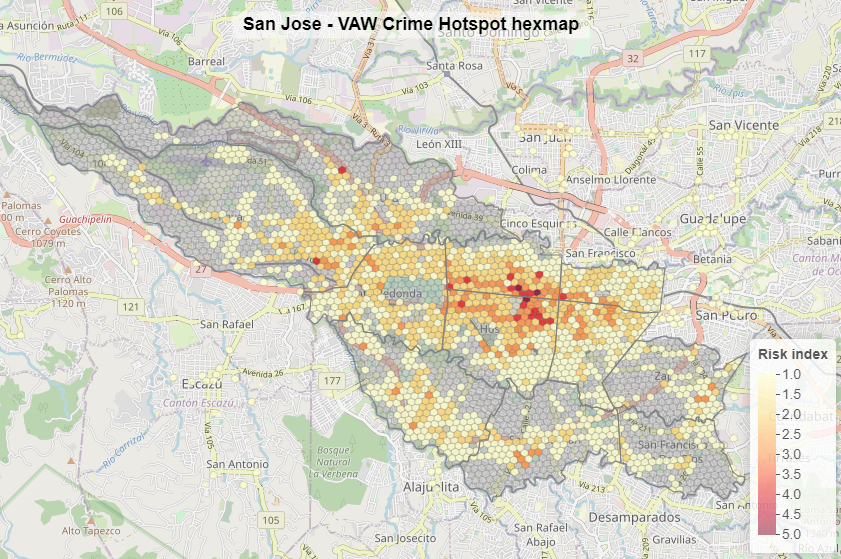

Grey areas mean zero risk index.

Maximum risk index is 5; there is no location with all 7 indicators "on", at least on this H3 hex aggregation level. The higher we go, the higher index we could get.

> See interactive map in **Visualizations** section.

We could further tune the "hotspot model" to better resemble our original crime density map. It all depends on which layers we put in the model, and if we start to apply different weights to the layers, we can further modify how these layers contribute to the overall hotspot score. Currently, we don't believe we have enough data and understanding about how different crime types actually happen on the streets of San Jose.
We also have to understand that a few hotspots, if many crimes happen there, can increase overall district level crime statistics significantly. What this hotspot map cannot tell is how many events actually happen on the yellow-red areas.
The exercise started with analysing VAW (Violence Against Women) cases, but the model can be generalized to other violent crimes, happening on public places.


### 4. Seasonal forecasting

Niels Bohr, the Nobel laureate in Physics is quoted as saying, “Prediction is very difficult, especially if it’s about the future!”  This is especially true when we have only static data (zones, buildings, pubs, etc.) but nothing really that varies over time.

Therefore what we can do is looking if we have any seasonality in crimes based on past data and assume that future will follow similar pattern.

In [43]:
### function to filter to SAN JOSÉ & to years, shape crime subtype names, count subtype crimes per groups passed to it. Adds year and month columns.

preproc <- function (tibi, grps)
{
  tibi %>%
  filter (canton == "SAN JOSE") %>%
  mutate (subtype_crime = str_replace (subtype_crime, " |/", "_")) %>%
  mutate (year = as.numeric(format(date,'%Y')), 
          month = as.numeric(format(date,'%m'))) %>%
  filter ((year >= 2012) & (year <= 2019)) %>%
  group_by_at (grps) %>%
  summarise (crime = n()) %>%
  ungroup() 
}


##### Seasonality each year by districts

Crimes are summed per district / year-month and aggregated to crime:

`summarise()` has grouped output by 'district', 'subtype_crime', 'year'. You can override using the
`.groups` argument.


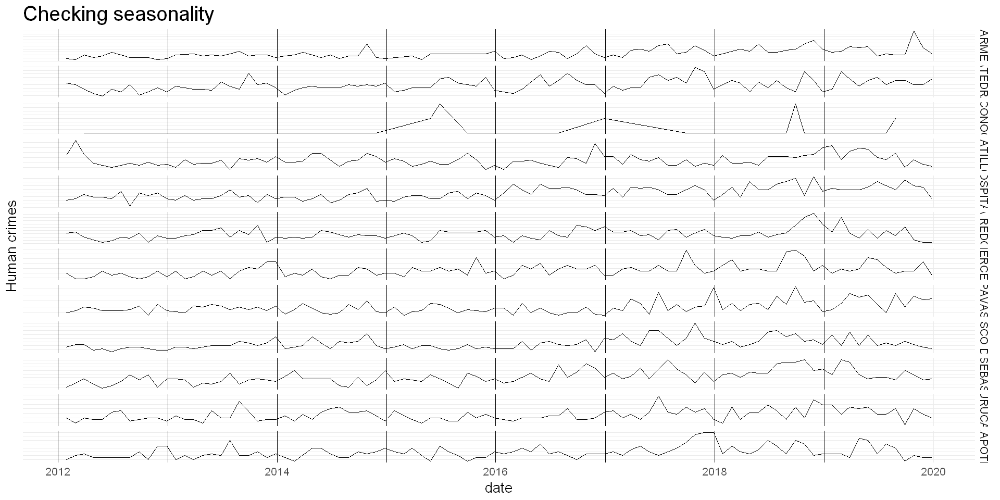

In [44]:
sj_crime_vaw %>%
  preproc (c("district", "subtype_crime", "year", "month")) %>%
  
  # subtype_crimes as columns and add total crimes
  pivot_wider (names_from = subtype_crime, 
               values_from = crime, names_prefix = "t_") %>%
  replace(is.na(.), 0) %>%
  mutate(t_crime = rowSums(select(., starts_with("t_")))  ) %>%
  
  # convert date to Date type
  mutate (date = as.Date(paste0 (year, "-", month, "-28"))) %>%
  
  # draw
  ggplot (aes (date, t_crime)) + 
  geom_line () +
  geom_vline(xintercept=as.Date(paste0(seq (2012,2019), "-01-01")))+
  facet_grid ( rows = vars(district), scales = "free_y") +
  theme_minimal() +
  theme(plot.title=element_text(size=24),
        text = element_text(size = 16), 
        axis.text.y=element_blank(),
        axis.ticks.y=element_blank()) +
  labs (y = "Human crimes", title = "Checking seasonality")


Looking at the districts with most crimes suggest that recently we have peak in around October. The picture is a bit messy, though.

##### Seasonality average year by districts

So let's see the average months, and to pick some systematic change, before and after half time fo the interval.

`summarise()` has grouped output by 'year'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'O'. You can override using the `.groups` argument.


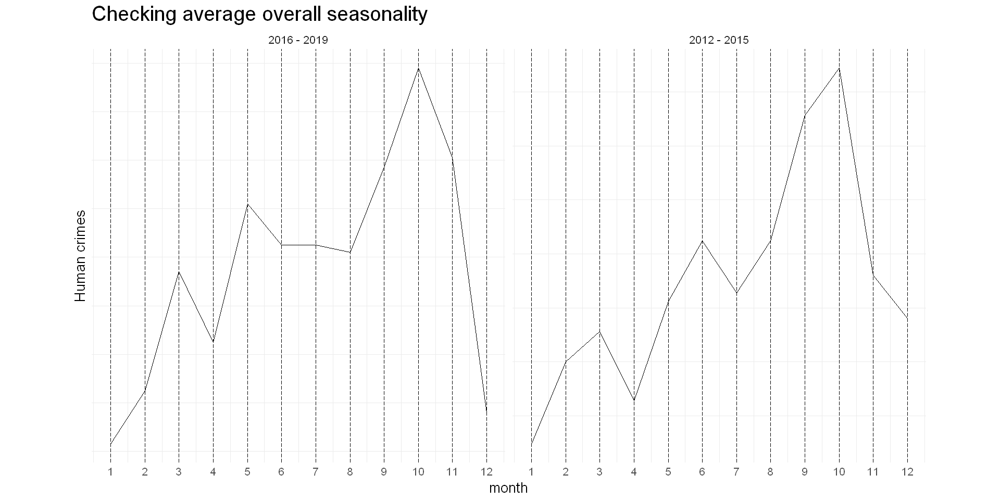

In [45]:
sj_crime_vaw %>% 
  preproc(c("year", "month")) %>%
  group_by (O = year < 2016, month) %>%
  summarise (crime = sum (crime)) %>%
  ggplot (aes (month, crime)) + 
  geom_line () +
  geom_vline(xintercept=seq (1,12), linetype="longdash")+
  #facet_grid ( rows = vars(district), scales = "free_y") +
  scale_x_continuous(breaks = seq (1,12)) +
  theme_minimal() +
  theme(axis.text.y=element_blank(),
        axis.ticks.y=element_blank()) +
  labs (y = "Human crimes", title = "Checking average overall seasonality") +
  facet_wrap (~O, scale = "free", 
              labeller = as_labeller (c(`TRUE` = "2012 - 2015", `FALSE` = "2016 - 2019"))) +
  theme(aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16))

Conclusion: it looks that when looking at the average of crimes against women, the lowest is in December - January, then goes, especially from July to October, form where it starts to drop.

Maybe this is driven by the crime-heavy districts only, so below a "district seasonality" is pictured.

##### District seasonality

`summarise()` has grouped output by 'district', 'year'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'O', 'month'. You can override using the `.groups` argument.


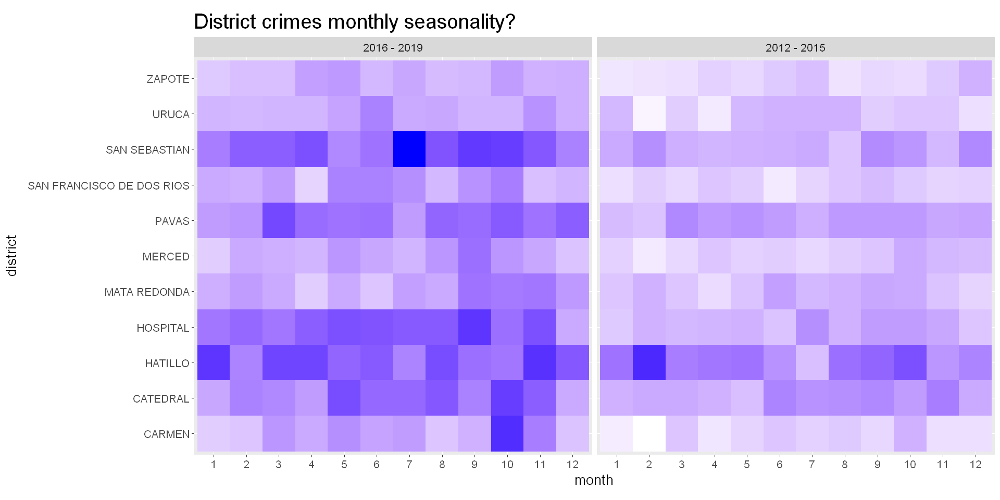

In [46]:
sj_crime_vaw %>%
  filter (district != "DESCONOCIDO") %>%
  preproc (c("district", "year", "month")) %>%
  group_by (O = year < 2016, month, district) %>%
  summarise (crime = sum (crime)) %>%
  
  ggplot (aes (as.factor(month), district, fill = crime)) +
  geom_tile() +
  scale_fill_gradient(low="white", high="blue") +
  labs (y = "district", x = "month", title = "District crimes monthly seasonality?") +
  theme (legend.position = "") +
  facet_grid (~O, scale = "free", 
              labeller = as_labeller (c(`TRUE` = "2012 - 2015", `FALSE` = "2016 - 2019")))+
  theme(aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16))



Indeed, our assumption was correct. There is no general seasonality in San José, what we see is the seasonality of some dominant districts (most notably, HOSPITAL, CATEDRAL, CARMEN). 

The picture also reveals something about the crime dynamics:

- Crime has grown substantially in the recent years.

- 3 of the four districts making up San José downtown (HOSPITAL, CATEDRAL, CARMEN) are leading in crimes, while the fourth one (MERCED) is pretty calm. Worth noting that CARMEN used to be a very peacuful district, which seamingly changed. (Same dramatic turn in case of SAN SEBASTIAN).

- HATILLO is one of the non downtown districts that picked up quite some crime recently (another one like that is SAN SEBASTIAN), and it has (also in the past) its own patterm very much different from the rest of the districts.

A relevant question after all: do crime types also have their own seasonal patterns? Let's check crime type seasonality then.

##### Crime type seasonality

`summarise()` has grouped output by 'subtype_crime', 'year'. You can override using the `.groups`
argument.
`summarise()` has grouped output by 'O', 'month'. You can override using the `.groups` argument.


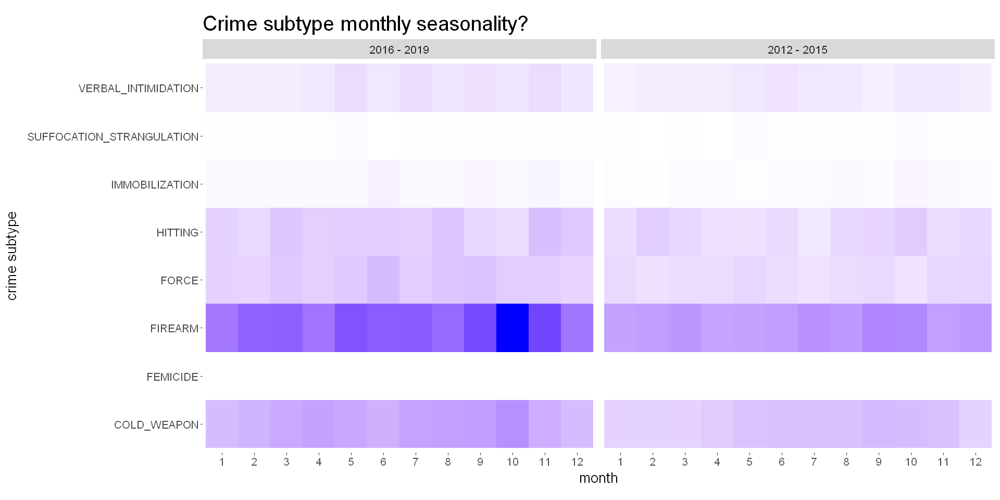

In [47]:
sj_crime_vaw %>%
  preproc (c("subtype_crime", "year", "month")) %>%
  group_by (O = year < 2016, month, subtype_crime) %>%
  summarise (crime = sum (crime)) %>%
  
  ggplot (aes (as.factor(month), subtype_crime, fill = crime)) + geom_tile() +
  scale_fill_gradient(low="white", high="blue") +
  labs (y = "crime subtype", x = "month", title = "Crime subtype monthly seasonality?") +
  theme(panel.background=element_rect(fill="white", colour="white")) +
  theme (legend.position = "") +
  facet_grid (~O, scale = "free", 
              labeller = as_labeller (c(`TRUE` = "2012 - 2015", `FALSE` = "2016 - 2019"))) +
  theme(aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16))



Yes, the assumption was right: some crimes have their own seasonality. The real worry is that the increase already noticed is driven by weapon attacks.

##### Hourly seasonality

`summarise()` has grouped output by 'subtype_crime', 'year'. You can override using the `.groups`
argument.
`summarise()` has grouped output by 'O', 'time'. You can override using the `.groups` argument.


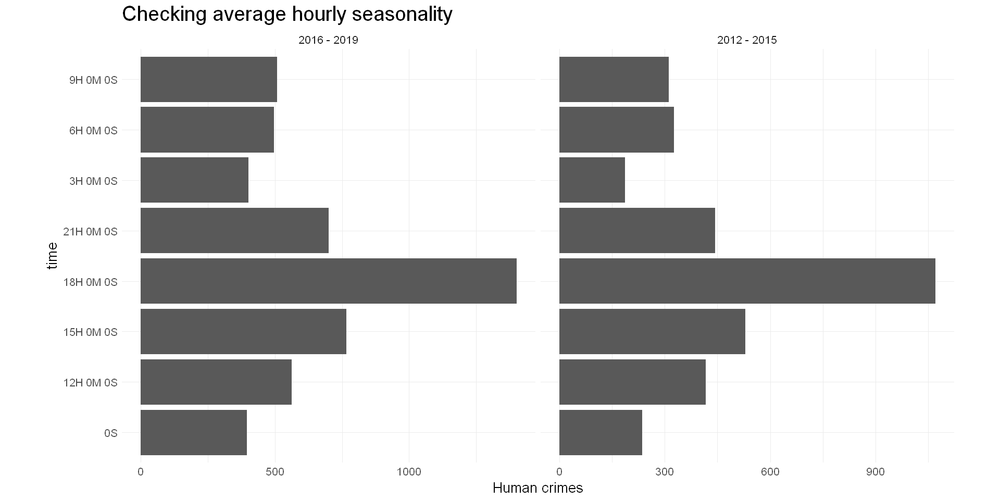

In [48]:
sj_crime_vaw %>% 
  mutate (time = as.character(time)) %>%
  preproc (c("subtype_crime", "year", "time")) %>%
  group_by (O = year < 2016, time, subtype_crime) %>%
  summarise (crime = sum (crime)) %>%
  ggplot (aes (time, crime)) + 
  geom_bar (stat = "identity") +
  theme_minimal() +
  labs (y = "Human crimes", title = "Checking average hourly seasonality") + coord_flip() +
  facet_grid (~O, scale = "free", 
              labeller = as_labeller (c(`TRUE` = "2012 - 2015", `FALSE` = "2016 - 2019"))) +
  theme(aspect.ratio = 1,
        plot.title=element_text(size=24),
        text = element_text(size = 16))


So finally one patternm that is constant over time. It looks that life rythm, sleeping cycles have not changed in San José recently..

## 🖼️ Visualisations

### Interactive maps - linked from gitlab

In [49]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_crime_density_pop.html" width="900", height="600"></iframe>')

In [50]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_crime_density_area.html" width="900", height="600"></iframe>')

In [51]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_transport.html" width="900", height="600"></iframe>')

In [52]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_park.html" width="900", height="600"></iframe>')

In [53]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_unsafe_park.html" width="900", height="600"></iframe>')

In [54]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_disjoint.html" width="900", height="600"></iframe>')

In [55]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_choice.html" width="900", height="600"></iframe>')

In [56]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_integration.html" width="900", height="600"></iframe>')

In [57]:
IRdisplay::display_html('<iframe src="http://peter.michaletzky.gitlab.io/dataproj_public/leaflet_hotspot.html" width="900", height="600"></iframe>')

## 👓 References

Challenge dataset:

* data/costa_rica_crimes_english.csv
* data/arcGIS_zoning_data_san_jose/arcGIS_districts.csv
* data/arcGIS_zoning_data_san_jose/arcGIS_zonas.csv
* data/arcGIS_zoning_data_san_jose/arcGIS_public_use_areas.csv
* data/reviews/google_reviews_transit.json
* data/reviews/google_reviews_parks.json

Openstreetmap.

INEC [www.inec.cr](www.inec.cr) public datasets:
* [Población 03 Costa Rica. Proyecciones de población según provincia, cantón y distrito al 30 de junio de cada año 2019-2020.](https://www.inec.cr/sites/default/files/documetos-biblioteca-virtual/repoblacionanuario2019-2020-03.xls)
* [Población 04 Costa Rica. Densidad de la población proyectada y estimada según provincia, cantón y distrito al 1 de julio de cada año 2019-2020.](https://www.inec.cr/sites/default/files/documetos-biblioteca-virtual/repoblacionanuario2019-2020-04.xls)
* [Población 21 Costa Rica: Densidad de la población proyectada y estimada según provincia, cantón y distrito al 1 de julio de cada año 2017-2019](https://www.inec.cr/sites/default/files/documetos-biblioteca-virtual/repoblacionanuario2017-2019-21.xls)
* [Población 20 Costa Rica: Estimaciones y Proyecciones de población según provincia, cantón y distrito al 30 de junio de cada año 2017-2019](https://www.inec.cr/sites/default/files/documetos-biblioteca-virtual/repoblacionanuario2017-2019-20.xls)

[Reglamento de Desarrollo Urbano del Cantón de San José. Disposiciones Generales](http://www.pgrweb.go.cr/scij/Busqueda/Normativa/Normas/nrm_texto_completo.aspx?param1=NRTC&nValor1=1&nValor2=76642&nValor3=95756&strTipM=TC)

Article:
* [Configuration of the street network:](https://link.springer.com/article/10.1007/s10940-016-9306-9)
* [Using heat maps to identify areas prone to violence against women in the public sphere](https://crimesciencejournal.biomedcentral.com/articles/10.1186/s40163-020-00125-6)


## ⏭️ Appendix
Add here any code, images or text that you still find relevant, but that was too long to include in the main report. This section is optional.